# Atividade Prática - Iniciação científica - Grupo EpiGeoData

### Objetivos:
#### Análise Descritiva
#### Análise Estatística
#### Análise Espacial

### -------- Sobre o SCZ em Pernambuco no periodo 2015 - 2024, Usando Dados Agregados por município. ---------

### Objetivos:
1. Preparação de Dados (DataTransforming + DataMerging + Main)
2. Exploração de Dados
3. Análise Temporal
4. Mapas
5. Testes de Autocorrelação Espacial
6. Identificação de Clusters
7. Modelagem (Regressão Espacial/Contagem)



# Atividade Prática - Iniciação científica - Grupo EpiGeoData

### Objetivos:
#### Análise Descritiva
#### Análise Estatística
#### Análise Espacial

### -------- Sobre o SCZ em Pernambuco no periodo 2015 - 2024, Usando Dados Agregados por município. ---------

### Objetivos:
1. Preparação de Dados (DataTransforming + DataMerging + Main)
2. Exploração de Dados
3. Análise Temporal
4. Mapas
5. Testes de Autocorrelação Espacial
6. Identificação de Clusters
7. Modelagem (Regressão Espacial/Contagem)

### Passos
1. Descrever temporalmente os casos de SCZ (2015–2024)
2. Mapear a distribuição espacial dos casos
3. Determinar fatores associados à variável resposta da situação.
4. Aplicação de testes (livre)
5. Produzir relatório com mapas, tabelas e interpretação (organize sua
produção, apresente os resultados, explique, comente e inclua os
dashboards do seu trabalho feito)

In [19]:
# Importações e Dataframe

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import itables

#Lendo csv
df = pd.read_csv('C:\\Users\\mateu\\Arquivos de Programas Faculdade\\Repositorios\\Analise-SCZ\\Data\\processed\\dados_unificados.csv')

#Realizando um mapeamento inicial dos dados para melhor visualização futura

col_names_map = {
    "ANO_NASC": "Ano de Nascimento",
    "ANO_NOT": "Ano da Notificação",
    "CEFALEIA": "Cefaleia (Sintoma)",
    "CLASSIFIN": "Classificação Final",
    "CLASS_FETO": "Classificação do Feto",
    "CODMUNNOT": "Código Município de Notificação",
    "CODMUNRES": "Código Município de Residência",
    "COMPRIMENT": "Comprimento ao Nascer (cm)",
    "CONJUNTIV": "Conjuntivite (Sintoma)",
    "CO_SEQ": "Código Sequencial do Registro",
    "CRITERIO": "Critérios de Classificação",
    "DEF_AUDIT": "Deficiência Auditiva",
    "DEF_NEURO": "Deficiência Neurológica",
    "DEF_VISUAL": "Deficiência Visual",
    "DIAMCEFAL": "Diâmetro Cefálico",
    "DOR_ARTIC": "Dor Articular",
    "DOR_MUSC": "Dor Muscular",
    "DT_NASC": "Data de Nascimento",
    "DT_NASCMAE": "Data de Nascimento da Mãe",
    "DT_NOTIFIC": "Data da Notificação",
    "DT_OBITO": "Data do Óbito",
    "DT_RS": "Data da Ressonância Magnética",
    "DT_SINTOMA": "Data do Início dos Sintomas",
    "DT_TC": "Data da Tomografia Computadorizada",
    "DT_TRANSF": "Data da Ultrassonografia Transfontanela",
    "DT_ULT_ALT": "Data da Última Alteração",
    "DT_USS": "Data da Ultrassonografia",
    "EDEMA": "Edema (Sintoma)",
    "ETIOLOGIA": "Etiologia",
    "EXAME_RS": "Exame de Ressonância Magnética",
    "EXAME_TC": "Exame de Tomografia Computadorizada",
    "EXAME_USS": "Exame de Ultrassonografia",
    "EXANT_GES": "Exantema na Gestação",
    "EXA_TORSCH": "Exame STORCH",
    "EXA_TRANSF": "Exame Ultrassonografia Transfontanela",
    "FEBRE_GES": "Febre na Gestação",
    "GEST_DIAG": "Idade Gestacional na Detecção",
    "GRAVIDEZ": "Tipo de Gravidez",
    "HIPERT_GAN": "Hipertensão Ganglionar",
    "HIST_ARBOV": "Histórico de Arbovírus",
    "HIST_MALFO": "Histórico de Malformação Congênita",
    "IDADEGES": "Idade da Gestante",
    "MICROCEFAL": "Microcefalia",
    "NEUROLOG": "Acidente Neurológico",
    "PCR_Z": "PCR para Zika",
    "PERIMCEFAL": "Perímetro Cefálico ao Nascer",
    "PESO": "Peso ao Nascer",
    "PRURIDO": "Prurido (Sintoma)",
    "RACACOR": "Raça ou Cor",
    "REGIAONOT": "Região da Notificação",
    "REGIAORES": "Região de Residência",
    "RESUL_C": "Resultado para Citomegalovírus",
    "RESUL_H": "Resultado para Herpes",
    "RESUL_S": "Resultado para Sífilis",
    "RESUL_TO": "Resultado para Toxoplasmose",
    "RESUL_Z": "Resultado para Zika",
    "RNEXA_TORS": "Exame STORCH no Recém-Nascido",
    "RNPCR_Z": "PCR para Zika no Recém-Nascido",
    "RNRESUL_C": "Resultado de Citomegalovírus no Recém-Nascido",
    "RNRESUL_H": "Resultado de Herpes no Recém-Nascido",
    "RNRESUL_S": "Resultado de Sífilis no Recém-Nascido",
    "RNRESUL_TO": "Resultado de Toxoplasmose no Recém-Nascido",
    "RNRESUL_Z": "Resultado de Zika no Recém-Nascido",
    "RNSO_IGG_Z": "IgG Zika no Recém-Nascido",
    "RNSO_IGM_Z": "IgM Zika no Recém-Nascido",
    "RNTR_IGG_Z": "Teste Rápido IgG Zika no Recém-Nascido",
    "RNTR_IGM_Z": "Teste Rápido IgM Zika no Recém-Nascido",
    "SEXO": "Sexo",
    "SO_IGG_Z": "IgG Zika Sorologia",
    "SO_IGM_Z": "IgM Zika Sorologia",
    "STATUS_NOT": "Status da Notificação",
    "ST_OBITO": "Status de Óbito",
    "TPDETECCAO": "Tipo de Detecção",
    "TP_NOTIFIC": "Tipo de Notificação",
    "TR_IGG_Z": "Teste Rápido IgG Zika",
    "TR_IGM_Z": "Teste Rápido IgM Zika",
    "UFNOT": "UF da Notificação",
    "UFRES": "UF de Residência",
    "__source_file": "Arquivo de Origem"
}

#Renomeando colunas
df.rename(columns=col_names_map, inplace=True)

#Salvando
df.to_csv('C:\\Users\\mateu\\Arquivos de Programas Faculdade\\Repositorios\\Analise-SCZ\\Data\\processed\\dados_unificados_renomeado.csv', index=False)

#Análise Exploratória Inicial

print("Dimensões do DataFrame:")
print(df.shape)
print("----------------------------")
print("10 primeiras linhas do DataFrame:")
itables.show(df.head(10))
print("----------------------------")
print("Informações do DataFrame:")
print(df.info())
print("----------------------------")
print("Estatísticas Descritivas:")
itables.show(df.describe())
print("----------------------------")
print("Valores Ausentes:")
print(df.isnull().sum())
print("----------------------------")
print("Duplicatas:")
print(df.duplicated().sum())
print("----------------------------")
print("Valores Únicos por Coluna:")
print(df.nunique())
print("----------------------------")
print("Colunas do DataFrame:")
print(df.columns)


Dimensões do DataFrame:
(3331, 79)
----------------------------
10 primeiras linhas do DataFrame:


Loading ITables v2.5.2 from the internet... (need help?)


----------------------------
Informações do DataFrame:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3331 entries, 0 to 3330
Data columns (total 79 columns):
 #   Column                                         Non-Null Count  Dtype  
---  ------                                         --------------  -----  
 0   Ano de Nascimento                              3251 non-null   float64
 1   Ano da Notificação                             3331 non-null   int64  
 2   Cefaleia (Sintoma)                             3331 non-null   int64  
 3   Classificação Final                            3331 non-null   int64  
 4   Classificação do Feto                          3160 non-null   float64
 5   Código Município de Notificação                3331 non-null   int64  
 6   Código Município de Residência                 3331 non-null   int64  
 7   Comprimento ao Nascer (cm)                     2698 non-null   float64
 8   Conjuntivite (Sintoma)                         3331 non-null   int64  
 9

Loading ITables v2.5.2 from the internet... (need help?)


----------------------------
Valores Ausentes:
Ano de Nascimento          80
Ano da Notificação          0
Cefaleia (Sintoma)          0
Classificação Final         0
Classificação do Feto     171
                         ... 
Teste Rápido IgG Zika    2741
Teste Rápido IgM Zika    2741
UF da Notificação           0
UF de Residência            0
Arquivo de Origem           0
Length: 79, dtype: int64
----------------------------
Duplicatas:
3
----------------------------
Valores Únicos por Coluna:
Ano de Nascimento        10
Ano da Notificação       10
Cefaleia (Sintoma)        2
Classificação Final       5
Classificação do Feto     3
                         ..
Teste Rápido IgG Zika     4
Teste Rápido IgM Zika     4
UF da Notificação        11
UF de Residência          1
Arquivo de Origem        10
Length: 79, dtype: int64
----------------------------
Colunas do DataFrame:
Index(['Ano de Nascimento', 'Ano da Notificação', 'Cefaleia (Sintoma)',
       'Classificação Final', 'Classificaçã

#### Pequenos insights preliminares

1. A média da idade gestacional é de 25.7 anos, e a mediana é 26 anos. Há uma grande variação nas idades das gestantes, com valores mínimos de 13 anos (poderia ser um caso de gravidez precoce) e máximos de 45 anos.

2. CEFALEIA: A média de ocorrência de cefaleia durante a gestação é 2.0 (indicando a maioria das gestantes não relataram esse sintoma), mas a mediana é 1 (portanto, a maior parte dos casos tem valor "não" ou "não relatado"). Já FEBRE_GES (Febre na Gestação): O valor médio é 2.0 e a mediana 1, indicando que a maioria das gestantes não teve febre.

3. Classificação do Feto e Tipo de Gravidez
CLASS_FETO: A distribuição da classificação do feto tem 1 (pré-termo) e 2 (a termo) como as categorias mais comuns, com média 1.8, sugerindo que a maioria dos fetos estão próximos do termo, mas também há um número considerável de partos pré-termo.
GRAVIDEZ: A maioria das gravidezes foi única (1), com valores mínimos de 1 e máximos de 9, indicando que o conjunto de dados tem poucas gestações múltiplas.

4. DEF_NEURO, DEF_AUDIT, DEF_VISUAL: A maioria dos registros apresenta não para essas deficiências, já que a média é 2 e a mediana é 2 (significa "não relatado" ou "não diagnosticado"). MICROCEFAL: A média é 1.96, que pode significar que a maioria dos casos reportou algum tipo de microcefalia associada à síndrome, já que 1 indica "microcefalia" e 2 pode indicar "outro tipo de alteração".

5. EXAME_USS (Ultrassonografia): A média dos exames realizados é 9 (não realizado) e a mediana também é 9, sugerindo que muitos dos registros não têm ultrassonografia realizada (ou relatada).
RESUL_Z (Resultado para Zika): A maioria dos casos tem resultado 9 (não realizado), mas alguns são 1 (positivo). Isso é consistente com a epidemia de Zika durante 2015-2017.
RESULTADOS PARA OUTROS EXAMES (como HERPES, TOXOPLASMOSE): A maior parte dos exames são não realizados (valor 9).

6. PERIMCEFAL: O perímetro cefálico ao nascer é média 34cm, o que está dentro da faixa normal para bebês a termo. 
Outros Sintomas Relatados
PRURIDO (comichão) tem uma média de 2.0, com a maioria dos casos indicando ausência de sintomas relacionados a esse sintoma específico.
DOR_ARTIC e DOR_MUSC: Ambas as variáveis têm médias próximas de 2.0, indicando que a maioria das gestantes não relataram dores articulares ou musculares.


In [20]:
#Mapeamento de Dados

category_map = {
    'TP_NOTIFIC': {
        '1': 'Recém-nascido com microcefalia (≤ 28 dias)',
        '2': 'Criança com microcefalia e/ou alterações do SNC (> 28 dias)',
        '3': 'Feto com alterações do SNC',
        '4': 'Feto em risco',
        '5': 'Natimorto com microcefalia e/ou alterações do SNC',
        '6': 'Aborto espontâneo (até 22 semanas de gestação)'
    },
    'MICROCEFAL': {
        '1': 'Microcefalia apenas',
        '2': 'Microcefalia com alteração do SNC',
        '3': 'Microcefalia com outras alterações congênitas',
        '4': 'Alterações congênitas sem microcefalia'
    },
    'RACACOR': {
        '1': 'Branca',
        '2': 'Negra',
        '3': 'Amarela',
        '4': 'Parda',
        '5': 'Indígena',
        '9': 'Ignorado'
    },
    'SEXO': {
        '1': 'Masculino',
        '2': 'Feminino',
        '9': 'Ignorado'
    },
    'CLASSIFIN': {
        '1': 'Confirmado',
        '2': 'Provável',
        '3': 'Em investigação',
        '4': 'Inconclusivo',
        '5': 'Descartado',
        '6': 'Excluído'
    },
    'ETIOLOGIA': {
        '1': 'Vírus Zika',
        '2': 'STORCH',
        '3': 'Coinfecção (STORCH + Zika)',
        '4': 'Etiologia desconhecida',
        '9': 'Ignorado'
    },
    'GRAVIDEZ': {
        '1': 'Única',
        '2': 'Dupla',
        '3': 'Tripla ou mais',
        '9': 'Ignorado'
    },
    'DEF_NEURO': {
        '1': 'Sim',
        '2': 'Não'
    },
    'DEF_AUDIT': {
        '1': 'Sim',
        '2': 'Não'
    },
    'DEF_VISUAL': {
        '1': 'Sim',
        '2': 'Não'
    },
    'TPDETECCAO': {
        '1': 'Intrauterino',
        '2': 'Pós-Parto',
        '3': 'Não detectada',
        '9': 'Ignorado'
    },
    'CLASS_FETO': {
        '1.0': 'Pré-Termo (menor que 37 semanas)',
        '2.0': 'A Termo (37 a 41 semanas)',
        '3.0': 'Pós-Termo (≥ 42 semanas)'
    },
    'EXA_TORSCH': {
        '1': 'Sim',
        '2': 'Não',
        '9': 'Ignorado'
    },
    'RESUL_S': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indetectável/Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'RESUL_TO': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indetectável/Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'RESUL_C': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indetectável/Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'RESUL_H': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indetectável/Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'RESUL_Z': {
        '1': 'Sim',
        '0': 'Não'
    },
    'EXAME_USS': {
        '1': 'Resultado Normal',
        '2': 'Resultado alterado, sugestivo de infecção congênita',
        '3': 'Resultado alterado, com outras alterações',
        '4': 'Resultado indeterminado',
        '5': 'Não realizado',
        '9': 'Ignorado'
    },
    'EXA_TRANSF': {
        '1': 'Resultado Normal',
        '2': 'Resultado alterado, sugestivo de infecção congênita',
        '3': 'Resultado alterado, com outras alterações',
        '4': 'Resultado indeterminado',
        '5': 'Não realizado',
        '9': 'Ignorado'
    },
    'EXAME_TC': {
        '1': 'Resultado Normal',
        '2': 'Resultado alterado, sugestivo de infecção congênita',
        '3': 'Resultado alterado, com outras alterações',
        '4': 'Resultado indeterminado',
        '5': 'Não realizado',
        '9': 'Ignorado'
    },
    'EXAME_RS': {
        '1': 'Resultado Normal',
        '2': 'Resultado alterado, sugestivo de infecção congênita',
        '3': 'Resultado alterado, com outras alterações',
        '4': 'Resultado indeterminado',
        '5': 'Não realizado',
        '9': 'Ignorado'
    },
    'ST_OBITO': {
        '1': 'Sim',
        '2': 'Não',
        '9': 'Ignorado'
    },
    'UFNOT': {
        '1': 'Norte',
        '2': 'Nordeste',
        '3': 'Sudeste',
        '4': 'Sul',
        '5': 'Centro Oeste'
    },
    'REGIAORES': {
        '1': 'Norte',   
        '2': 'Nordeste',
        '3': 'Sudeste',
        '4': 'Sul',
        '5': 'Centro Oeste'
    },
    'REGIAONOT': {
        '1': 'Norte',
        '2': 'Nordeste',
        '3': 'Sudeste',
        '4': 'Sul',
        '5': 'Centro Oeste'
    },
    'FEBRE_GES': {
        '1': 'Sim',
        '2': 'Não',
        '9': 'Ignorado'
    },
    'EXANT_GES': {
        '1': 'Sim, no 1º trimestre',
        '2': 'Sim, no 2º trimestre',
        '3': 'Sim, no 3º trimestre',
        '4': 'Sim, mas não sabe informar o trimestre',
        '5': 'Não teve exantema',
        '9': 'Não sabe'
    },
    'HIST_ARBOV': {
        '1': 'Dengue',
        '2': 'Chikungunya',
        '3': 'Denggue e Chikungunya',
        '4': 'Sem histórico de doenças',
        '9': 'Ignorado'
    },
    'HIST_MALFO': {
        '1': 'Sim',
        '2': 'Não',
        '9': 'Ignorado'
    },
    'PRURIDO': {
        '1': 'Sim',
        '2': 'Não',
        '9': 'Ignorado'
    },
    'CEFALEIA': {
        '1': 'Sim',
        '2': 'Não',
        '9': 'Ignorado'
    },
    'DOR_MUSC': {
        '1': 'Sim',
        '2': 'Não',
        '9': 'Ignorado'
    },
    'DOR_ARTIC': {
        '1': 'Sim',
        '2': 'Não',
        '9': 'Ignorado'
    },
    'CONJUNTIV': {
        '1': 'Sim',
        '2': 'Não',
        '9': 'Ignorado'
    },
    'EDEMA': {
        '1': 'Sim',
        '2': 'Não',
        '9': 'Ignorado'
    },
    'PCR_Z': {
        '1': 'Detectável/Positivo',
        '2': 'Não detectável/Negativo',
        '3': 'Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'SO_IGM_Z': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'SO_IGG_Z': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'TR_IGM_Z': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'TR_IGG_Z': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'STATUS_NOT': {
        '1': 'Ativa',
        '2': 'Encerrada',
        '3': 'inativo'
    },
    'TPDETECCAO': {
        '1': 'Intrauterino',
        '2': 'Pós-parto',
        '3': 'Não detectada',
        '9': 'Ignorado'
    },
    'HIPERT_GAN': {
        '1': 'Sim',
        '2': 'Não'
    },
    'NEUROLOG': {
        '1': 'Sim',
        '2': 'Não'
    },
    'RNEXA_TORS': {
        '1': 'Sim',
        '2': 'Não',
        '9': 'Ignorado'
    },
    'RNRESUL_S': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indetectável/Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'RNRESUL_TO': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indetectável/Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'RNRESUL_C': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indetectável/Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'RNRESUL_H': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indetectável/Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'RNRESUL_Z': {
        '1': 'Sim',
        '0': 'Não'
    },
    'RNSO_IGG_Z': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indetectável/Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'RNSO_IGM_Z': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indetectável/Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'RNTR_IGG_Z': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indetectável/Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'RNTR_IGM_Z': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indetectável/Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },
    'RNPCR_Z': {
        '1': 'Reagente/Positivo',
        '2': 'Não reagente/Negativo',
        '3': 'Indetectável/Indeterminado',
        '4': 'Não realizado',
        '9': 'Ignorado'
    },

    
}

# Função para aplicar o mapeamento de categorias
def map_categories(df, category_map):
    for column, category_dict in category_map.items():
        if column in df.columns:
            df[column] = df[column].astype(str)
            df[column] = df[column].map(category_dict).fillna(df[column])  # Preenche valores ausentes com os originais
    return df

# Carregar o dataset
df = pd.read_csv("C:\\Users\\mateu\\Arquivos de Programas Faculdade\\Repositorios\\Analise-SCZ\\Data\\processed\\dados_unificados.csv")

# Aplicar o mapeamento de categorias
df_mapped = map_categories(df, category_map)

# Salvar o dataset com as categorias mapeadas
df_mapped.to_csv("dados_unificados_com_map.csv", index=False)

# Exibir as primeiras linhas para verificar

itables.show(df_mapped.head())


Loading ITables v2.5.2 from the internet... (need help?)


In [21]:
#Aplicando novamente o mapeamento agora no dataframe mapeado

df_mapped.rename(columns=col_names_map, inplace=True)

#Visualização
itables.show(df_mapped.head(10))

#Exportando como dadospara_análise_mapeados
df_mapped.to_csv('C:\\Users\\mateu\\Arquivos de Programas Faculdade\\Repositorios\\Analise-SCZ\\Data\\processed\\dados_unificados_mapeado_renomeado.csv', index=False)

Loading ITables v2.5.2 from the internet... (need help?)


##### Remoção de Colunas desnecessárias

1. Código Sequencial do Registro (CO_SEQ): Este é um identificador único de cada registro e, em geral, não é necessário para análise exploratória, pois não traz informação útil para as variáveis dependentes ou independentes.

2. Data de Nascimento da Mãe (DT_NASCMAE): Não adiciona muita coisa na análise exploratoria ainda mais considerando que a idade da mãe consta em outra coluna

 

In [22]:
# Remoção
colunas_a_remover = [
    "Código Sequencial do Registro",
    "Data de Nascimento da Mãe"
]
df_mapped.drop(columns=colunas_a_remover, inplace=True)

## Exploração dos Dados

#### Distribuições, Histogramas e Scatterplots

C:\Users\mateu\AppData\Local\Temp\ipykernel_21396\2905853222.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




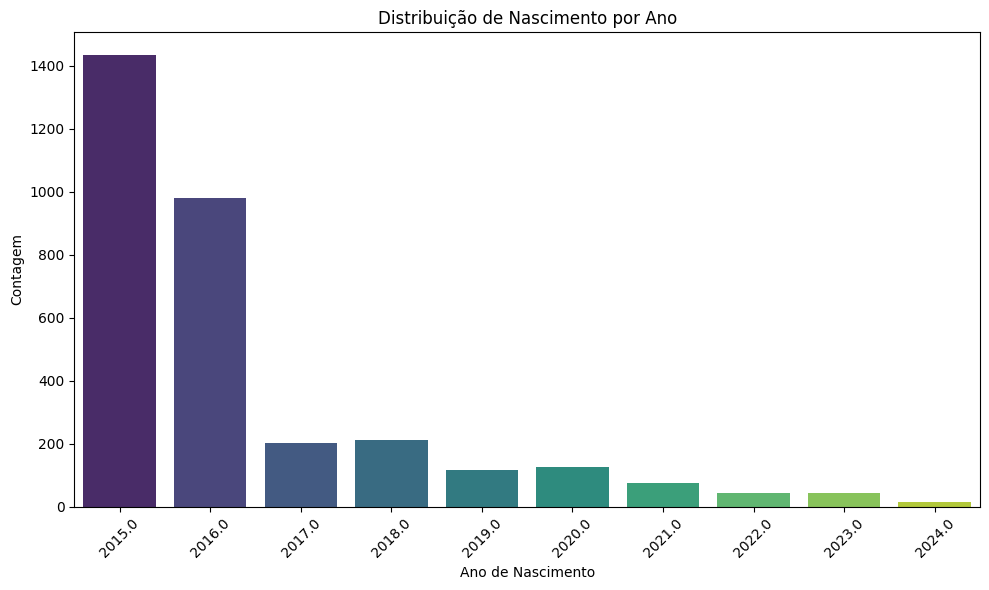

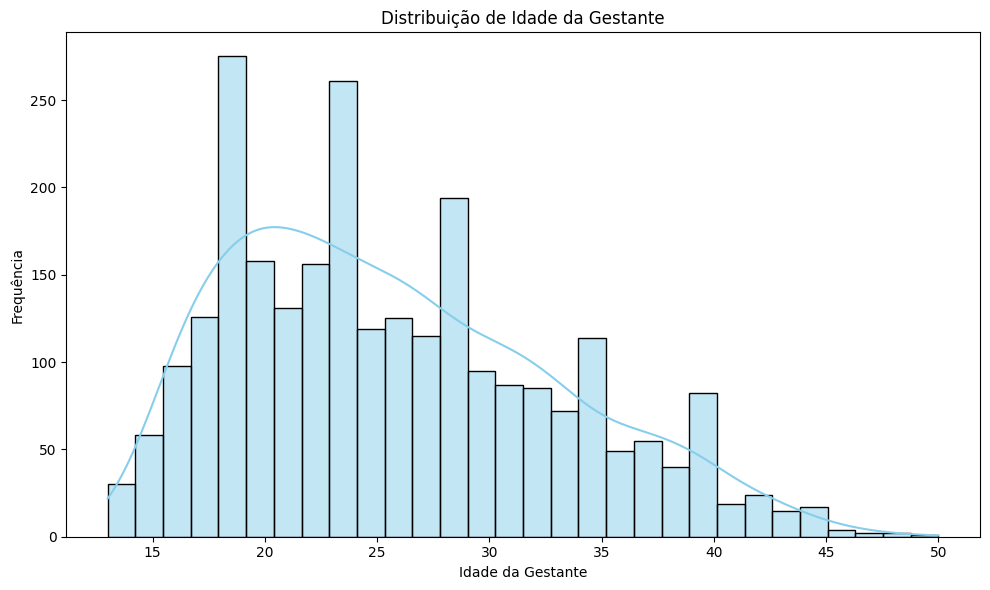

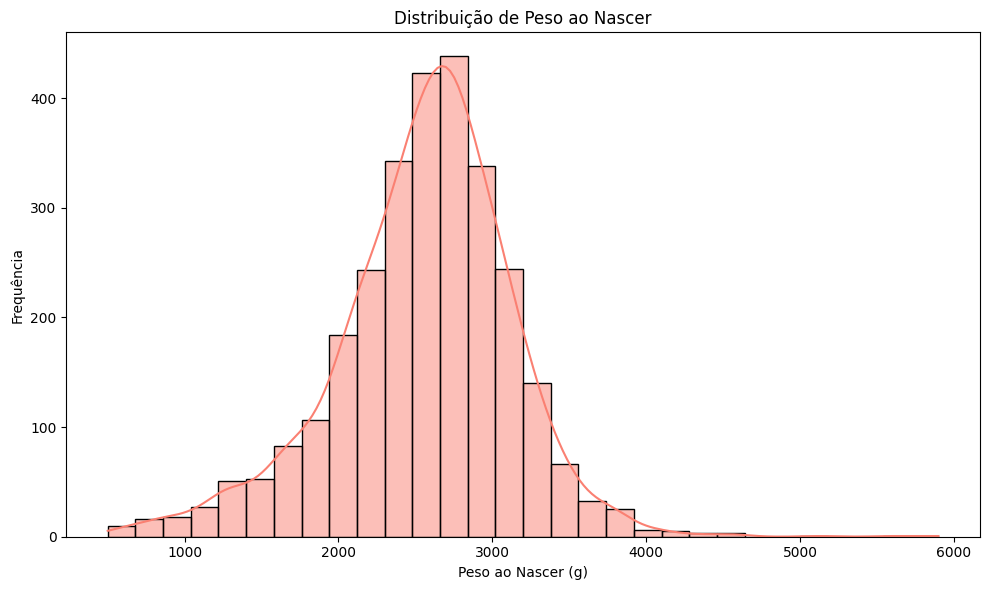

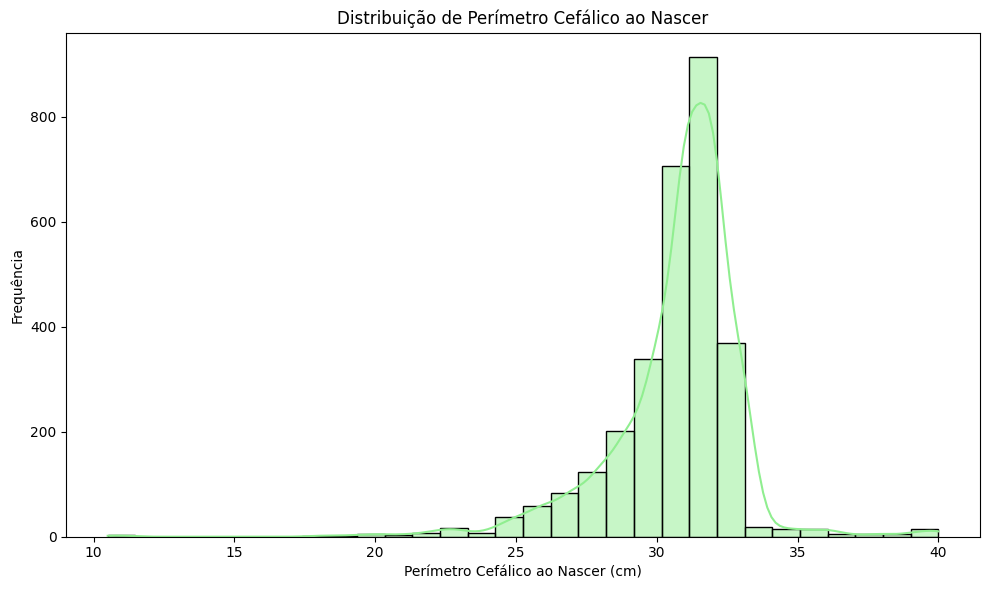

C:\Users\mateu\AppData\Local\Temp\ipykernel_21396\2905853222.py:47: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




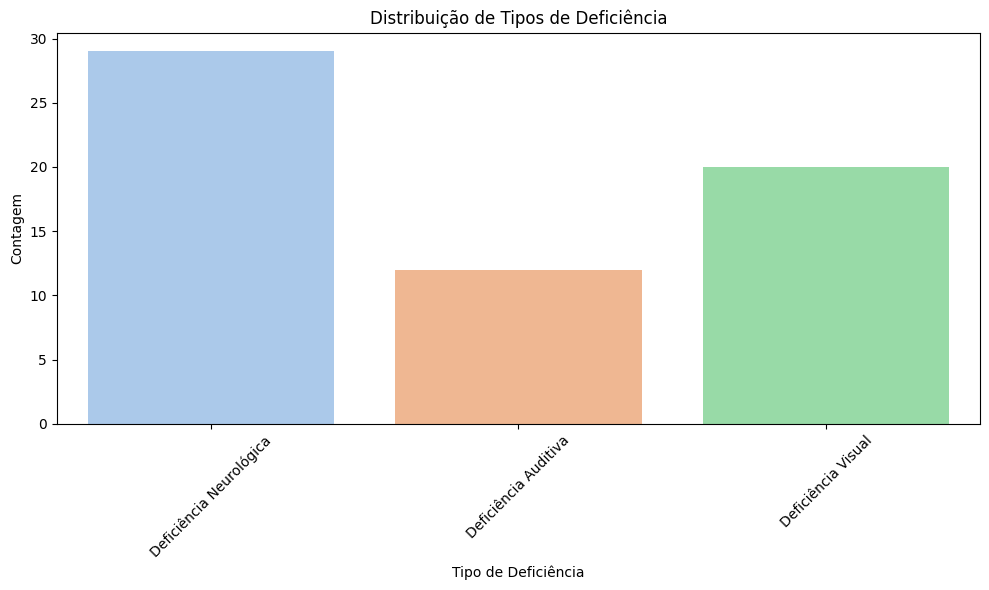

In [23]:
# Distribuição de Nascimento por Ano

plt.figure(figsize=(10, 6))
sns.countplot(data=df_mapped, x='Ano de Nascimento', palette='viridis')
plt.title('Distribuição de Nascimento por Ano')
plt.xlabel('Ano de Nascimento')
plt.ylabel('Contagem')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Distribuição de Idade Gestacional

plt.figure(figsize=(10, 6))
sns.histplot(data=df_mapped, x='Idade da Gestante', bins=30, kde=True, color='skyblue')
plt.title('Distribuição de Idade da Gestante')
plt.xlabel('Idade da Gestante')
plt.ylabel('Frequência')
plt.tight_layout()
plt.show()

# Distribuição de Peso ao Nascer

plt.figure(figsize=(10, 6))
sns.histplot(data=df_mapped, x='Peso ao Nascer', bins=30, kde=True, color='salmon')
plt.title('Distribuição de Peso ao Nascer')
plt.xlabel('Peso ao Nascer (g)')
plt.ylabel('Frequência')
plt.tight_layout()
plt.show()

#Distribuição de Perímetro Cefálico ao Nascer
plt.figure(figsize=(10, 6))
sns.histplot(data=df_mapped, x='Perímetro Cefálico ao Nascer', bins=30, kde=True, color='lightgreen')
plt.title('Distribuição de Perímetro Cefálico ao Nascer')
plt.xlabel('Perímetro Cefálico ao Nascer (cm)')
plt.ylabel('Frequência')
plt.tight_layout()
plt.show()

# Gráfico de Barras unico para tipos de deficiência
deficiencias = ['Deficiência Neurológica', 'Deficiência Auditiva', 'Deficiência Visual']

deficiencias_counts = {defic: df_mapped[defic].value_counts().get('Sim', 0) for defic in deficiencias}

plt.figure(figsize=(10, 6))
sns.barplot(x=list(deficiencias_counts.keys()), y=list(deficiencias_counts.values()), palette='pastel')
plt.title('Distribuição de Tipos de Deficiência')
plt.xlabel('Tipo de Deficiência')
plt.ylabel('Contagem')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


#### Interpretações
##### Distribuição de Nascimento por Ano
A grande concentração de casos no ano de 2015 sugere uma alta incidência de microcefalia e outras condições relacionadas ao Zika, provavelmente devido à epidemia de Zika nesse período. Isso pode indicar um pico de casos associados ao vírus no período crítico de infecção, o que foi muito documentado no Brasil. Após 2015, os casos diminuem consideravelmente, com poucos casos em anos subsequentes. Isso pode refletir uma diminuição na incidência do vírus ou uma melhoria no controle das infecções.

##### Idade da Gestante
A maioria das gestantes está na faixa etária entre 15 e 30 anos, com uma concentração maior de casos entre 20 e 25 anos. Nada disso é necessáriamente uma indicação para a microssefalia, visto que, a maioria das gestantes em geral se concentra nessa faixa. Porem, **A cauda direita (maior idade) pode sugerir que, embora a maioria das gestantes seja jovem, também há um número considerável de gestantes com idades mais avançadas**, o que pode ser relevante para a situação.

##### Peso ao Nascer
O gráfico de peso ao nascer mostra uma distribuição normalmente inclinada para a direita, com a maioria dos bebês nascendo com peso entre 2500g e 3500g. No entanto, a presença de outliers pode indicar casos de bebês com baixo peso ao nascer, o que pode ser indicativo de prematuridade ou outras complicações relacionadas à infecção por Zika. Porem, a maioria dos nascimentos foi saudavel em termos de peso.

##### Perímetro Cefálico ao Nascer
A distribuição do perímetro cefálico também segue um padrão normal, mas com uma cauda à esquerda. A maioria dos bebês tem um perímetro cefálico saudável (cerca de 34-35 cm), mas a presença de uma **cauda mais à esquerda indica a presença de bebês com microcefalia**.

##### Deficiências
A maior parte dos casos está associada a deficiência neurológica, como esperado devido à natureza da Síndrome Congênita da Zika (SCZ), que pode resultar em comprometimento neurológico (como microcefalia e outras alterações cerebrais). Esse gráfico mostra que a deficiência neurológica é a mais prevalente entre os casos analisados
A deficiência visual também tem uma presença significativa nos casos, embora não tão alta quanto a deficiência neurológica. Isso pode estar relacionado a danos ao sistema nervoso central causado pela infecção, que muitas vezes afeta a visão
A deficiência auditiva tem menos prevalência em comparação com as outras deficiências. Esse valor é mais baixo, sugerindo que embora a infecção por Zika possa afetar a audição em alguns casos, essa não é a condição mais comum entre os casos de microcefalia então, há uma consistência nos dados.

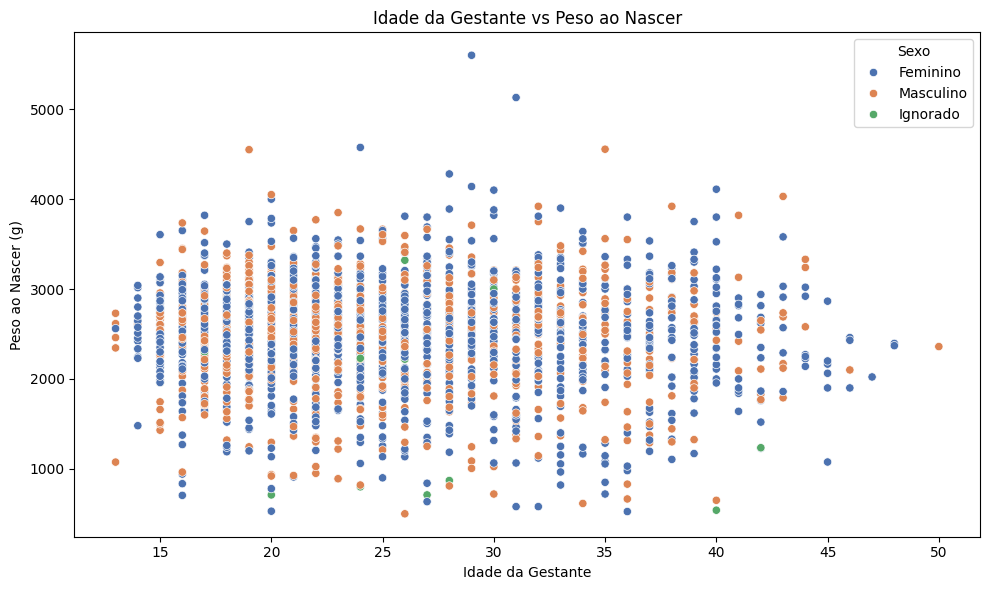

Loading ITables v2.5.2 from the internet... (need help?)


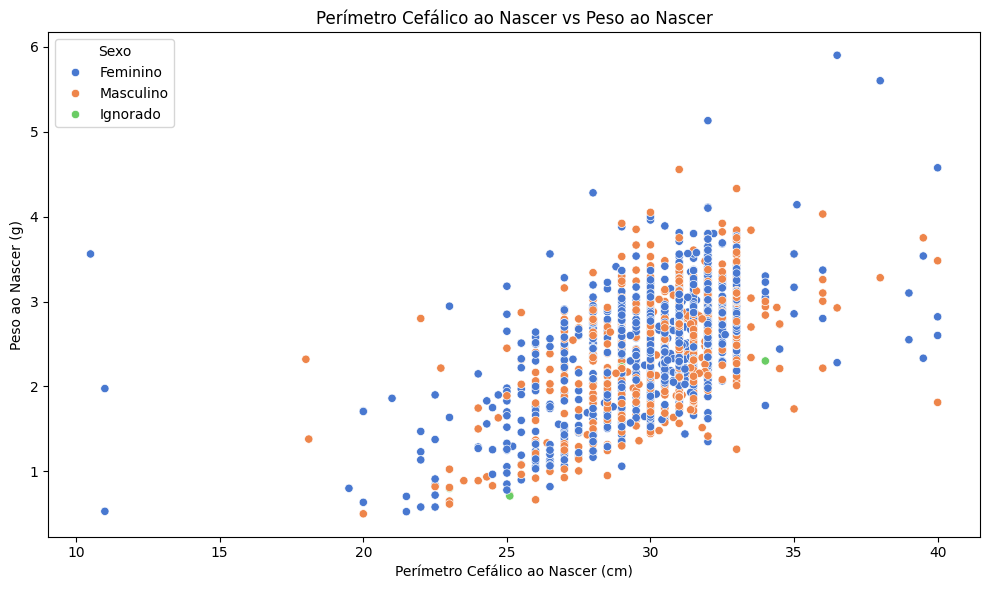

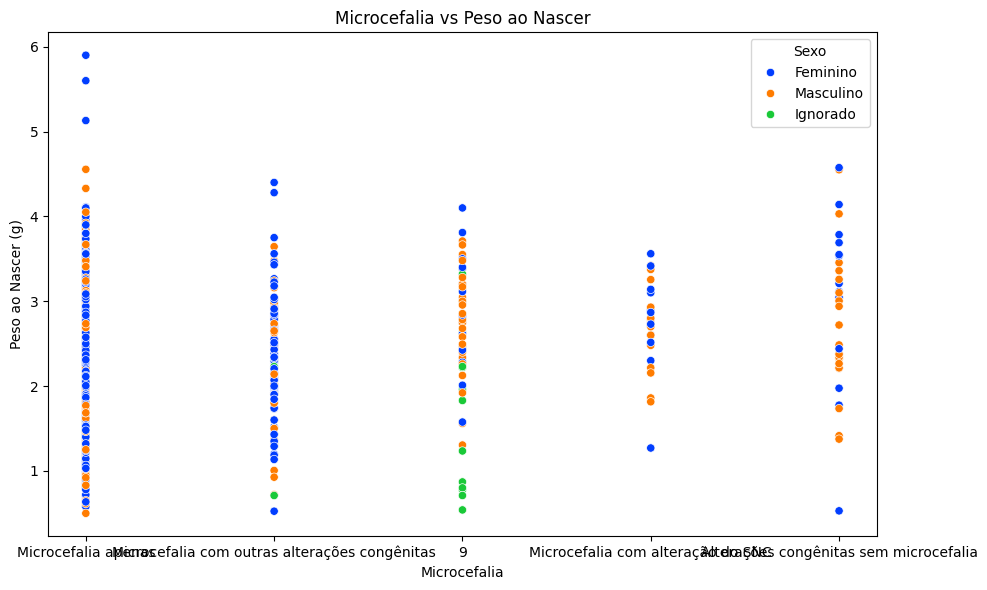

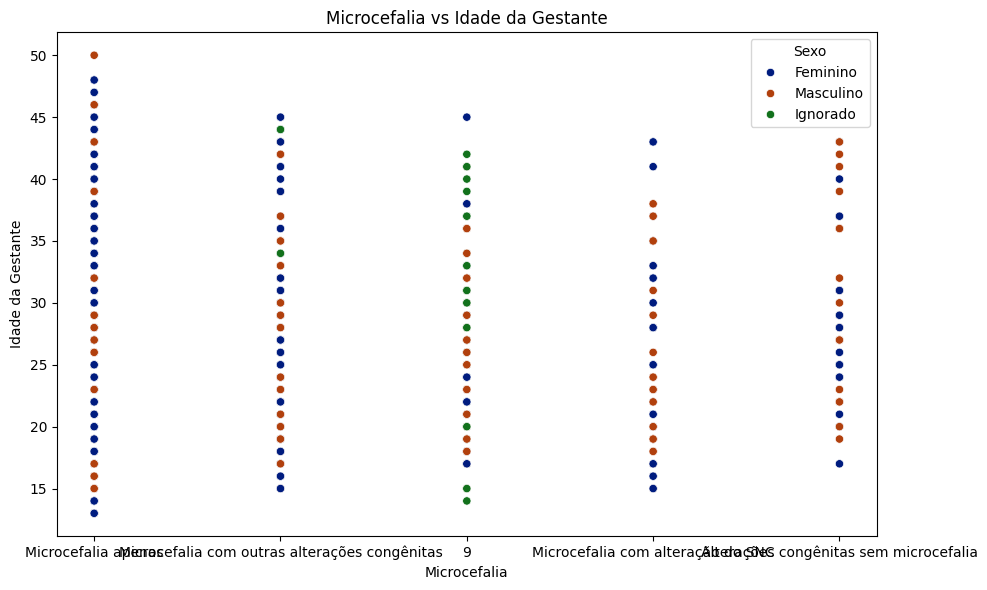

Loading ITables v2.5.2 from the internet... (need help?)


Idade da Gestante
20.0    10
34.0    10
28.0    10
41.0    10
32.0    10
33.0    10
22.0    10
15.0    10
36.0    10
42.0    10
44.0    10
43.0    10
13.0    10
48.0    10
45.0    10
50.0    10
46.0    10
23.0    10
29.0    10
39.0    10
40.0    10
38.0    10
17.0    10
37.0    10
26.0    10
25.0    10
19.0    10
24.0    10
27.0    10
31.0    10
14.0    10
16.0    10
30.0    10
35.0    10
21.0    10
18.0    10
47.0    10
Name: count, dtype: int64


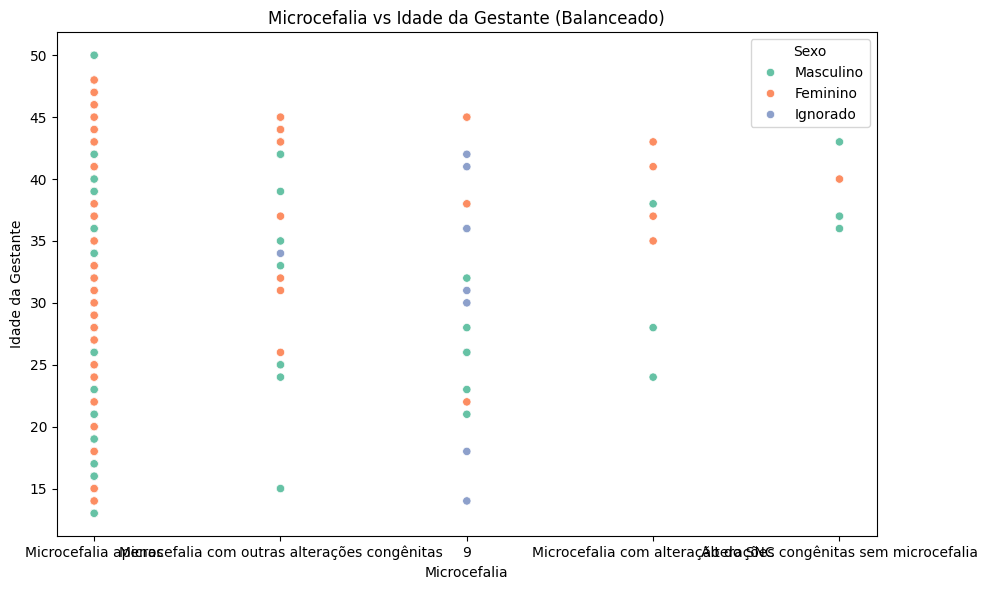

In [24]:
#Scatterplots

#Idade Gestacional e Peso ao Nascer
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df_mapped, x='Idade da Gestante', y='Peso ao Nascer', hue='Sexo', palette='deep')
plt.title('Idade da Gestante vs Peso ao Nascer')
plt.xlabel('Idade da Gestante')
plt.ylabel('Peso ao Nascer (g)')
plt.tight_layout()
plt.show()

#Calculo de Média de Peso por Idade + Variância e Desvio Padrão de Peso por idade
df_mapped['Peso ao Nascer'] = df_mapped['Peso ao Nascer'] / 1000  # Convertendo para kg
peso_por_idade = df_mapped.groupby('Idade da Gestante')['Peso ao Nascer'].agg(['mean', 'var', 'std']).reset_index()
itables.show(peso_por_idade)


#Perímetro Cefálico ao Nascer e Peso ao Nascer
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df_mapped, x='Perímetro Cefálico ao Nascer', y='Peso ao Nascer', hue='Sexo', palette='muted')
plt.title('Perímetro Cefálico ao Nascer vs Peso ao Nascer')
plt.xlabel('Perímetro Cefálico ao Nascer (cm)')
plt.ylabel('Peso ao Nascer (g)')
plt.tight_layout()
plt.show()

#Microcefalia e Peso ao Nascer
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df_mapped, x='Microcefalia', y='Peso ao Nascer', hue='Sexo', palette='bright')
plt.title('Microcefalia vs Peso ao Nascer')
plt.xlabel('Microcefalia')
plt.ylabel('Peso ao Nascer (g)')
plt.tight_layout()
plt.show()

#Microcefalia e idade Gestacional
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df_mapped, x='Microcefalia', y='Idade da Gestante', hue='Sexo', palette='dark')
plt.title('Microcefalia vs Idade da Gestante')
plt.xlabel('Microcefalia')
plt.ylabel('Idade da Gestante')
plt.tight_layout()
plt.show()

#Histórico de Arbovírus e Microcefalia (Com plotly)
fig = px.histogram(df_mapped[df_mapped['Histórico de Arbovírus'] != 'ignorado'], x='Histórico de Arbovírus', color='Microcefalia', barmode='group', height=400)
fig.update_layout(title='Histórico de Arbovírus e Microcefalia', xaxis_title='Histórico de Arbovírus', yaxis_title='Contagem')
fig.show()

#Taxa de Historico de Doenças para Microcefalia
hist_arbov_micro = df_mapped[df_mapped['Histórico de Arbovírus'] != 'ignorado'].groupby('Histórico de Arbovírus')['Microcefalia'].value_counts(normalize=True).unstack().fillna(0) * 100
itables.show(hist_arbov_micro)

# Criação de um Dataset com as classes balanceadas (Idade gestacional) para verificar novamente
from sklearn.utils import resample
# Separar as classes
classes = df_mapped['Idade da Gestante'].unique()
# Encontrar o tamanho da menor classe
min_size = df_mapped['Idade da Gestante'].value_counts().min()
# Balancear cada classe
balanced_dfs = []
for cls in classes:
    if pd.isna(cls):
        continue  # Skip nan classes
    cls_df = df_mapped[df_mapped['Idade da Gestante'] == cls]
    if len(cls_df) == 0:
        continue  # Skip empty classes
    # Use replace=True if there are fewer than 10 samples
    replace_flag = len(cls_df) < 10
    balanced_cls_df = resample(cls_df, replace=replace_flag, n_samples=10, random_state=42)
    balanced_dfs.append(balanced_cls_df)
# Concatenar todas as classes balanceadas
df_balanced = pd.concat(balanced_dfs)
# Verificar o balanceamento
print(df_balanced['Idade da Gestante'].value_counts())
# Visualização após balanceamento
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df_balanced, x='Microcefalia', y='Idade da Gestante', hue='Sexo', palette='Set2')
plt.title('Microcefalia vs Idade da Gestante (Balanceado)')
plt.xlabel('Microcefalia')
plt.ylabel('Idade da Gestante')
plt.tight_layout()
plt.show()


#### Interpretações

1. Idade da Gestante vs Peso ao Nascer
relação entre idade da gestante e peso ao nascer é visível neste gráfico de dispersão. Pode-se observar uma distribuição mais densa de pontos na faixa etária 20-35 anos, com a maioria dos bebês nascendo dentro da faixa normal de peso.
Gestantes muito jovens (13–16 anos) e mais velhas (acima de 40) tendem a apresentar médias de peso ao nascer um pouco menores, sugerindo maior risco de baixo peso. O desvio padrão é maior em algumas faixas (ex: 35–36 anos), indicando maior dispersão dos pesos ao nascer nessas idades, possivelmente por maior heterogeneidade clínica ou social. Idades com poucos casos (ex: 47, 48, 50) têm variância e desvio padrão muito baixos ou nulos, indicando poucos registros e menor confiabilidade estatística. Faixa de 20–30 anos apresenta médias mais altas e menor variabilidade, reforçando que é o grupo de menor risco para baixo peso ao nascer.


2. Perímetro Cefálico ao Nascer vs Peso ao Nascer
Existe uma correlação positiva entre o perímetro cefálico e o peso ao nascer. Bebês com perímetros cefálicos maiores tendem a ter mais peso ao nascer, o que é esperado, já que microcefalia é frequentemente associada a bebês com peso mais baixo.
O gráfico também sugere que a maior parte dos bebês apresenta perímetros cefálicos dentro da faixa normal, com alguns casos mais extremos, possivelmente associados à microcefalia.

3. Microcefalia vs Peso ao Nascer
A microcefalia está claramente associada a bebês com menor peso ao nascer. Como esperado, bebês com microcefalia apresentam peso ao nascer mais baixo (Talvez a exceção daqueles com alteração no SNC).
Este gráfico ajuda a confirmar a relação entre microcefalia e baixo peso e pode servir para identificar a gravidade da condição.

4. Microcefalia vs Idade da Gestante
Microcefalia é observada em todas as faixas etárias, mas não há uma relação direta clara entre a idade da gestante e a ocorrência de microcefalia segundo o gráfico.
Mesmo assim, podemos ver que a microcefalia está mais distribuída entre as gestantes de 20 a 40 anos. Isso pode indicar que a idade materna não é o único fator de risco para a microcefalia, já que casos também são encontrados em gestantes mais jovens e mais velhas. Tambem pode indicar que, a base de dados desbalanceada aponta mais casos de microcefalia no geral na classe majoritária. Gestações mais velhas não necessariamente estão associadas a um aumento em casos de microcefalia. Percebemos porem que, com o Dataset Balanceado (Ou seja, para cada 10 casos em cada idade) é visivel que para idades mais elevadas, há mais casos de microcefalia com outras alterações congênitas e microcefalia com alteração do SNC.

5. Histórico de Arbovírus e Sexo
Se houver um gráfico envolvendo arbovírus (como Dengue e Chikungunya) e sexo, você pode estar buscando uma diferença na distribuição de arbovírus entre os sexos dos bebês.

Isso pode ajudar a entender se há mais casos de infecção por Zika, Dengue ou Chikungunya em bebês do sexo masculino ou feminino. Uma análise mais detalhada pode revelar se um sexo está mais vulnerável a essas condições, embora no geral, doenças arbovirais como Zika afetam ambos os sexos igualmente.

C:\Users\mateu\AppData\Local\Temp\ipykernel_21396\4208941530.py:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




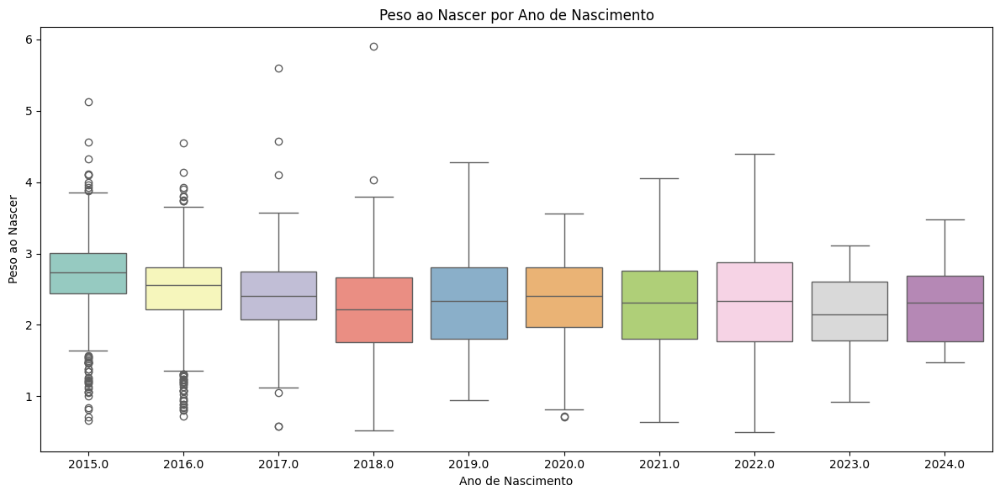

C:\Users\mateu\AppData\Local\Temp\ipykernel_21396\4208941530.py:14: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




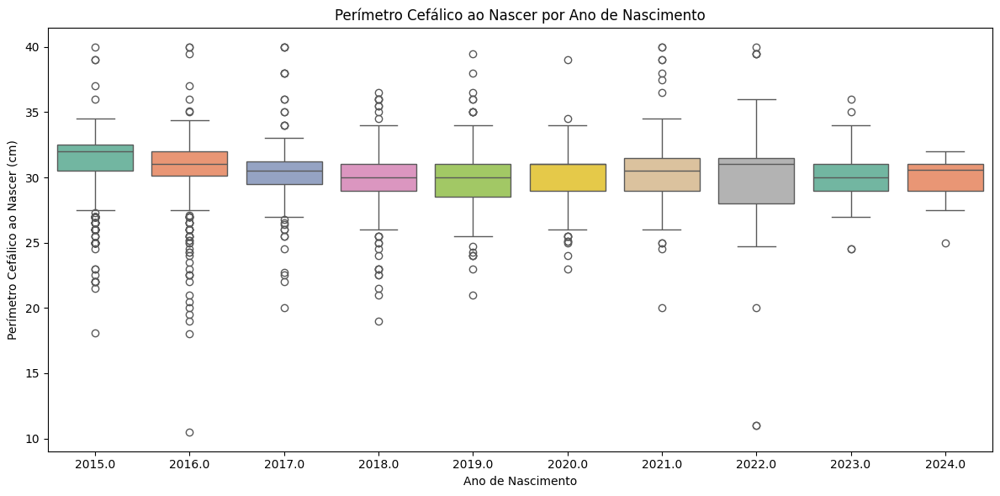

In [25]:
# Boxplots

# Peso ao Nascer por Ano de Nascimento
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_mapped, x='Ano de Nascimento', y='Peso ao Nascer', palette='Set3')
plt.title('Peso ao Nascer por Ano de Nascimento')
plt.xlabel('Ano de Nascimento')
plt.ylabel('Peso ao Nascer')
plt.tight_layout()
plt.show()

# Perimetro Cefálico ao Nascer por Ano de Nascimento
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_mapped, x='Ano de Nascimento', y='Perímetro Cefálico ao Nascer', palette='Set2')
plt.title('Perímetro Cefálico ao Nascer por Ano de Nascimento')
plt.xlabel('Ano de Nascimento')
plt.ylabel('Perímetro Cefálico ao Nascer (cm)')
plt.tight_layout()
plt.show()

##### Interpretação

1. O Peso ao nascer permanece relativamente estavel ao longo dos anos
2. Em 2015/2016 anos apresentam maior quantidade de outliers abaixo de 2 kg, o que sugere maior incidência de baixo peso — possivelmente reflexo direto da epidemia de Zika e da síndrome congênita que atingiu gestantes nesses anos. 2015 e 2016 possuem muitos outliers abaixo de 28 cm no segundo gráfico, sugerindo altos índices de microcefalia nesses períodos. Nos anos seguintes a distribuição se torna mais concentrada, com menos casos fora da faixa normal. Isso indica redução da ocorrência de microcefalia nos anos pós-epidemia. Outliers altos podem representar variações naturais (bebês maiores), não necessariamente anômalas.

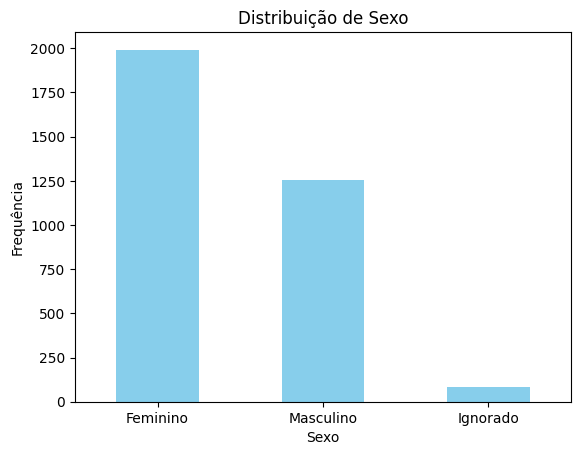

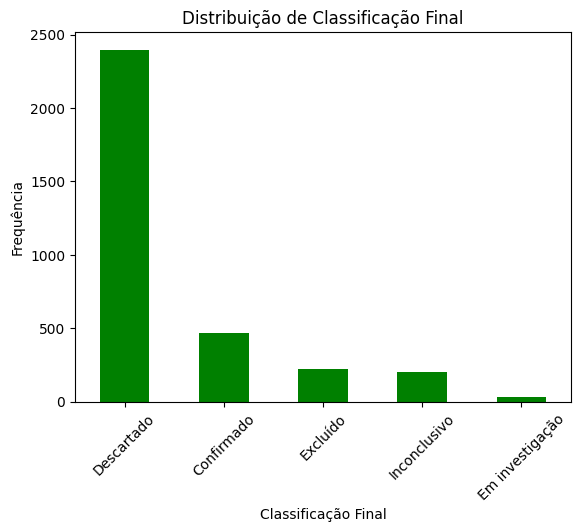

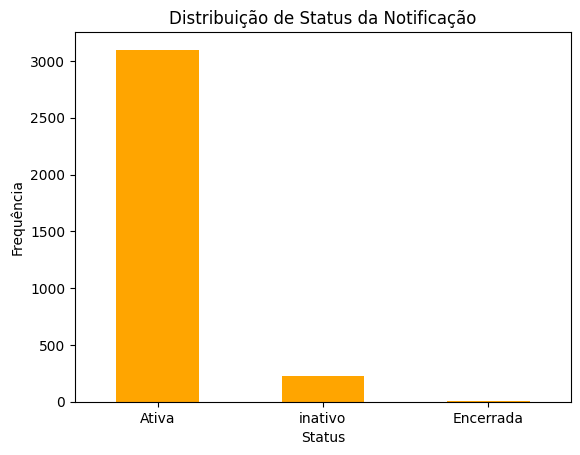

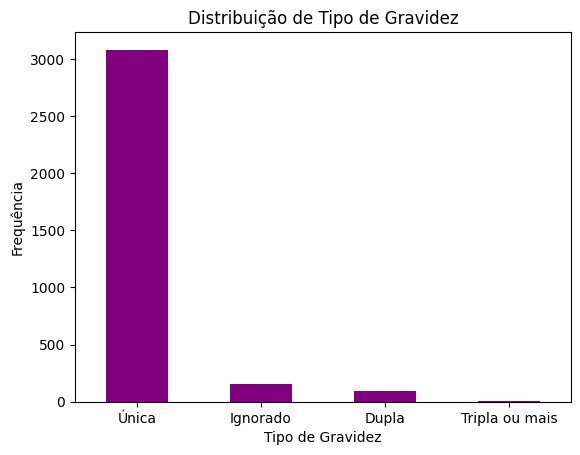

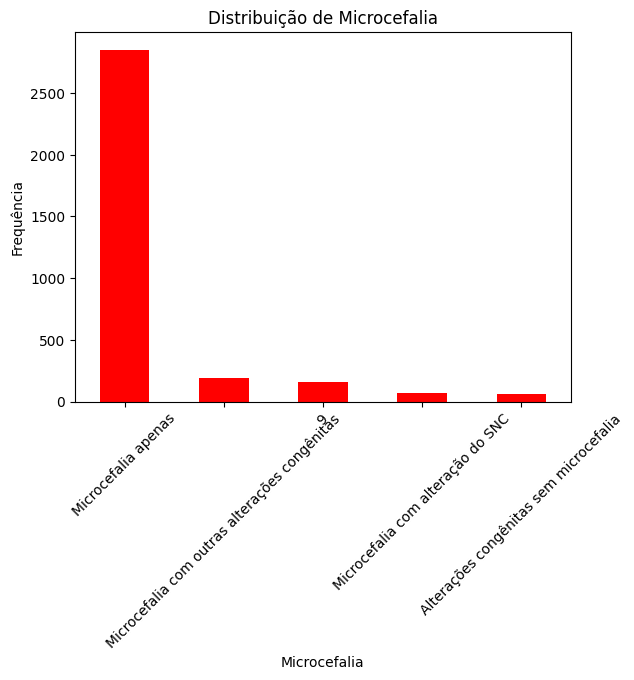

In [26]:
#Análise de Variaveis Categóricas

#Sexo
df['Sexo'].value_counts().plot(kind='bar', color='skyblue')
plt.title('Distribuição de Sexo')
plt.xlabel('Sexo')
plt.ylabel('Frequência')
plt.xticks(rotation=0)
plt.show()

#Classificação Final
df['Classificação Final'].value_counts().plot(kind='bar', color='green')
plt.title('Distribuição de Classificação Final')
plt.xlabel('Classificação Final')
plt.ylabel('Frequência')
plt.xticks(rotation=45)
plt.show()

#Status da Notificação
df['Status da Notificação'].value_counts().plot(kind='bar', color='orange')
plt.title('Distribuição de Status da Notificação')
plt.xlabel('Status')
plt.ylabel('Frequência')
plt.xticks(rotation=0)
plt.show()

#Tipo de Gravidez
df['Tipo de Gravidez'].value_counts().plot(kind='bar', color='purple')
plt.title('Distribuição de Tipo de Gravidez')
plt.xlabel('Tipo de Gravidez')
plt.ylabel('Frequência')
plt.xticks(rotation=0)
plt.show()

#Microcefalia
df['Microcefalia'].value_counts().plot(kind='bar', color='red')
plt.title('Distribuição de Microcefalia')
plt.xlabel('Microcefalia')
plt.ylabel('Frequência')
plt.xticks(rotation=45)
plt.show()


#### Interpretação

1. Distribuição de Sexo

A frequência de recém-nascidos do sexo feminino, masculino e ignorado.
Predominância feminina: A maior parte dos registros corresponde a bebês do sexo feminino (~2000 casos), superando os masculinos (~1250).
Essa diferença pode estar relacionada a viés de registro, diferenças biológicas ou simplesmente amostragem.
O número de casos "Ignorado" é baixo, o que é positivo para a qualidade dos dados — pouca perda de informação nesse campo.
A variável sexo está bem distribuída e completa, podendo ser usada em análises cruzadas com microcefalia, peso ao nascer e tipo de gravidez.

2. Distribuição de Classificação Final

A situação final da notificação de SCZ (confirmado, descartado, inconclusivo etc.).

Descartados representam a grande maioria dos casos (~2400).
Confirmados aparecem em número muito menor (~500), seguidos por excluídos e inconclusivos, com proporções próximas.
Em investigação são poucos — provavelmente casos mais recentes ou sem desfecho confirmado até a data do registro.

A epidemia pode ter levado a um grande número de notificações preventivas, mas poucos casos confirmados.
Isso reflete o cenário epidemiológico do pós-2015, quando o sistema de vigilância passou a registrar com cautela todos os casos suspeitos, mesmo sem confirmação laboratorial.

3. Distribuição de Status da Notificação

O status atual das notificações — se ainda estão ativas, encerradas ou inativas.
A esmagadora maioria está ativa (>3000 casos), o que pode indicar:
Que o dataset inclui notificações em andamento (sem desfecho final).
Ou que a base não foi atualizada com o encerramento de vários registros antigos.
Poucos casos encerrados sugerem um processo administrativo lento ou falta de atualização no sistema.
A predominância de notificações ativas reforça a importância de revisar e atualizar o banco para melhorar a qualidade e rastreabilidade dos dados.

4. Distribuição de Tipo de Gravidez

Os tipos de gestação (única, dupla, tripla, ignorada).
A grande maioria das gestações é única (~3000 casos), o que é esperado — gestações múltiplas são raras.
Há poucos registros de duplas e triplas, o que está dentro da normalidade biológica.


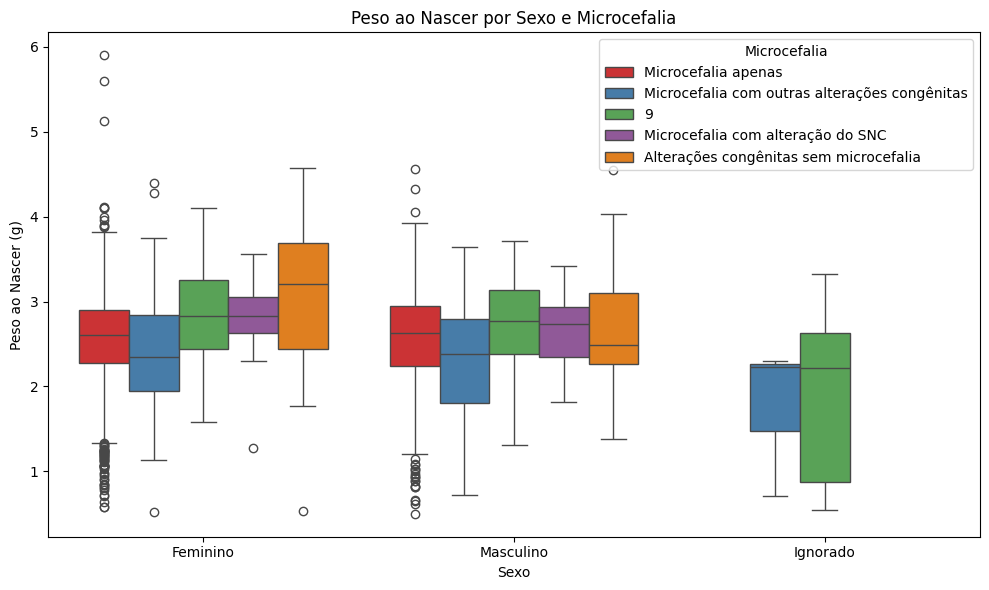

In [27]:
# Análises cruzadas com microcefalia, peso ao nascer e tipo de gravidez.

plt.figure(figsize=(10, 6))
sns.boxplot(data=df_mapped, x='Sexo', y='Peso ao Nascer', hue='Microcefalia', palette='Set1')
plt.title('Peso ao Nascer por Sexo e Microcefalia')
plt.xlabel('Sexo')
plt.ylabel('Peso ao Nascer (g)')
plt.tight_layout()
plt.show()

##### Interpretação

Percebe-se que a influência da microcefalia não é necessáriamente ligada ao sexo.

# Análise Temporal


C:\Users\mateu\AppData\Local\Temp\ipykernel_21396\2784229414.py:18: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




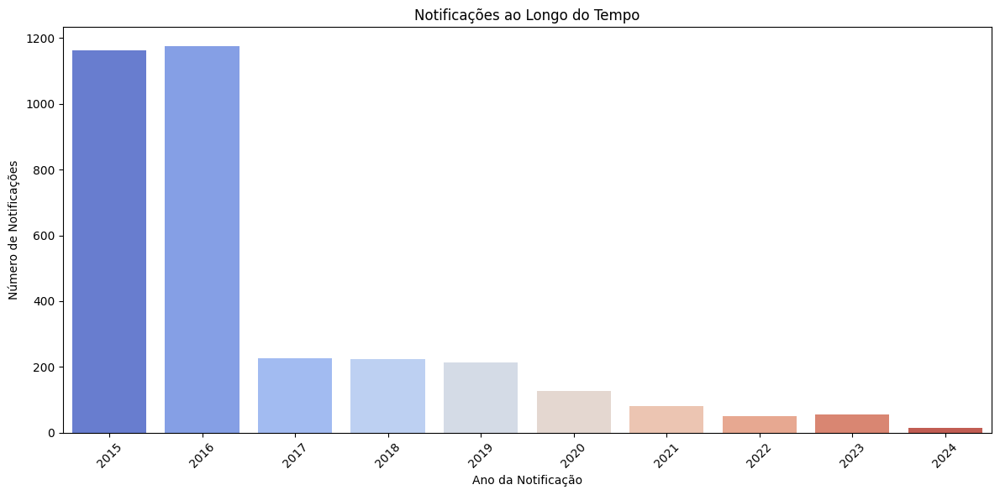

C:\Users\mateu\AppData\Local\Temp\ipykernel_21396\2784229414.py:28: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




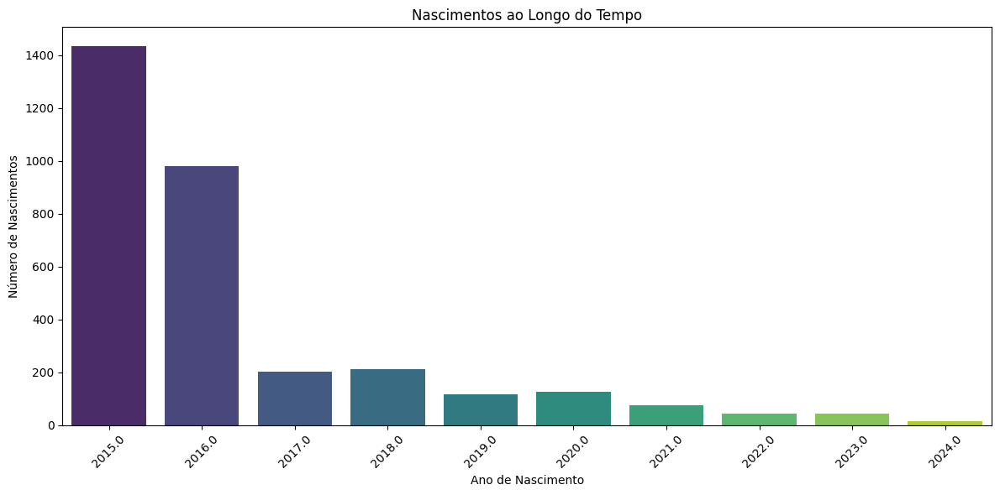

C:\Users\mateu\AppData\Local\Temp\ipykernel_21396\2784229414.py:38: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




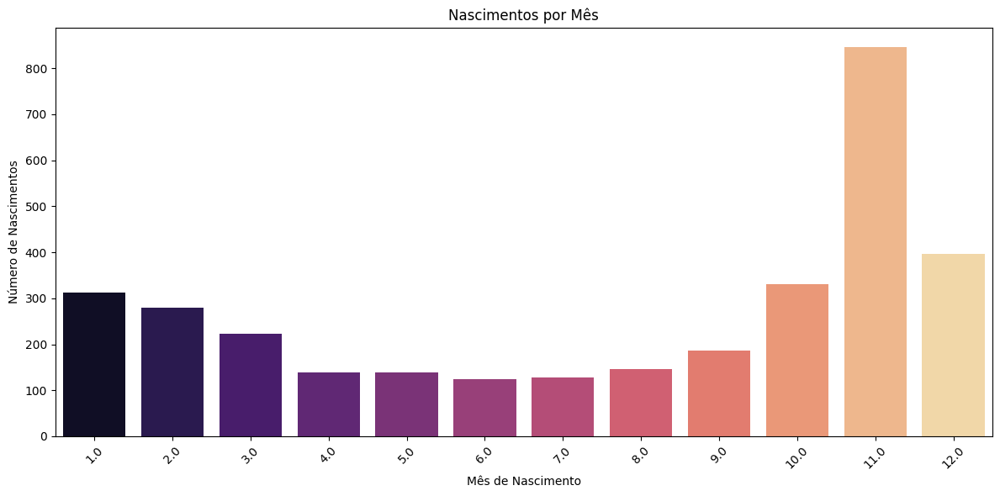

C:\Users\mateu\AppData\Local\Temp\ipykernel_21396\2784229414.py:48: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




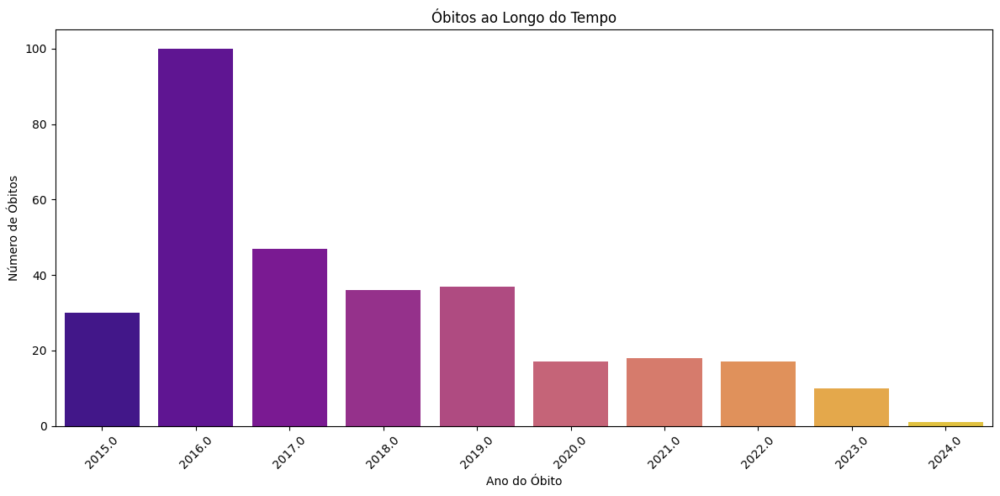

C:\Users\mateu\AppData\Local\Temp\ipykernel_21396\2784229414.py:58: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




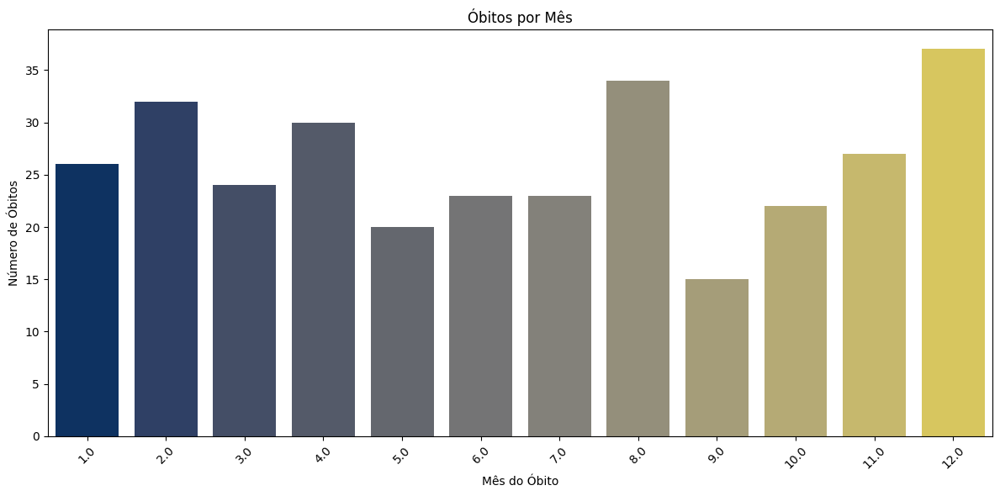

Loading ITables v2.5.2 from the internet... (need help?)


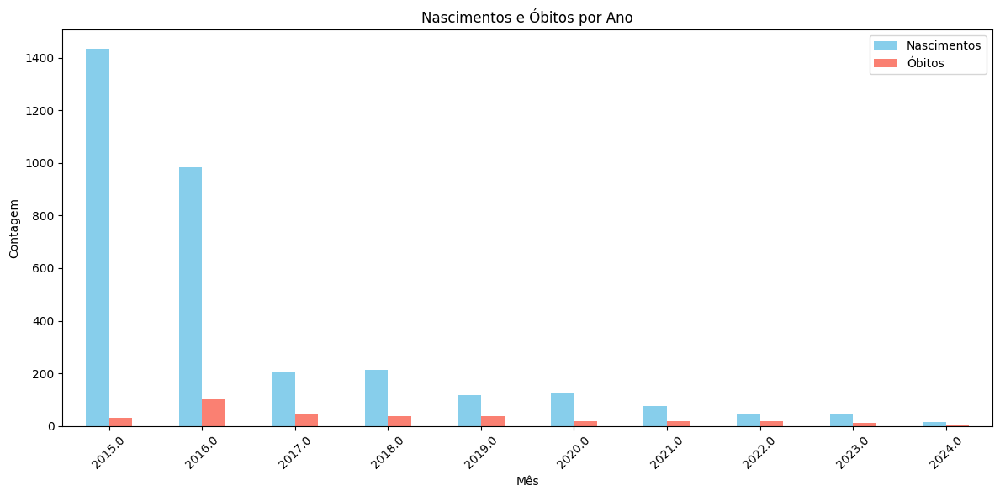

Loading ITables v2.5.2 from the internet... (need help?)


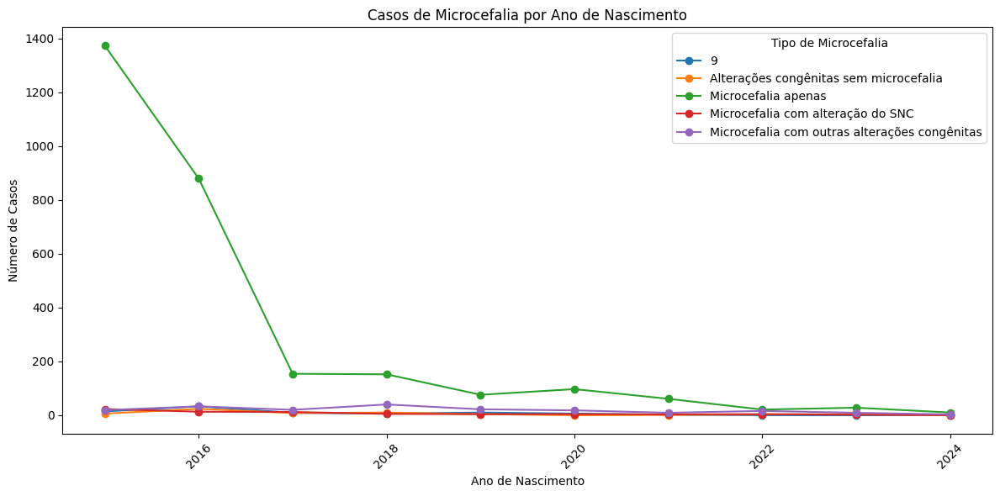

Loading ITables v2.5.2 from the internet... (need help?)


In [28]:
#Conversão de Variaveis de Data (Data da Notificação, Data de Nascimento, Data do Óbito, etc.) para o tipo datetime)

df_mapped['Data da Notificação'] = pd.to_datetime(df_mapped['Data da Notificação'], format='%Y-%m-%d')
df_mapped['Data de Nascimento'] = pd.to_datetime(df_mapped['Data de Nascimento'], format='%Y-%m-%d')
df_mapped['Data do Óbito'] = pd.to_datetime(df_mapped['Data do Óbito'], format='%Y-%m-%d')

#Criação de Colunas Derivadas (Ano e Mês extraidos de Cada Data)
df_mapped['Ano da Notificação'] = df_mapped['Data da Notificação'].dt.year
df_mapped['Mês da Notificação'] = df_mapped['Data da Notificação'].dt.month
df_mapped['Ano de Nascimento'] = df_mapped['Data de Nascimento'].dt.year
df_mapped['Mês de Nascimento'] = df_mapped['Data de Nascimento'].dt.month
df_mapped['Ano do Óbito'] = df_mapped['Data do Óbito'].dt.year
df_mapped['Mês do Óbito'] = df_mapped['Data do Óbito'].dt.month

# Análise Temporal
#Data de Notificação ao Longo do Tempo
plt.figure(figsize=(12, 6))
sns.countplot(data=df_mapped, x='Ano da Notificação', palette='coolwarm')
plt.title('Notificações ao Longo do Tempo')
plt.xlabel('Ano da Notificação')
plt.ylabel('Número de Notificações')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#Data de Nascimento ao Longo do Tempo (Ano)
plt.figure(figsize=(12, 6))
sns.countplot(data=df_mapped, x='Ano de Nascimento', palette='viridis')
plt.title('Nascimentos ao Longo do Tempo')
plt.xlabel('Ano de Nascimento')
plt.ylabel('Número de Nascimentos')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#Data de Nascimento ao Longo do Tempo (Mês)
plt.figure(figsize=(12, 6))
sns.countplot(data=df_mapped, x='Mês de Nascimento', palette='magma')
plt.title('Nascimentos por Mês')
plt.xlabel('Mês de Nascimento')
plt.ylabel('Número de Nascimentos')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#Data de Óbito ao Longo do Tempo (Ano)
plt.figure(figsize=(12, 6))
sns.countplot(data=df_mapped, x='Ano do Óbito', palette='plasma')
plt.title('Óbitos ao Longo do Tempo')
plt.xlabel('Ano do Óbito')
plt.ylabel('Número de Óbitos')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#Data de Óbito ao Longo do Tempo (Mês)
plt.figure(figsize=(12, 6))
sns.countplot(data=df_mapped, x='Mês do Óbito', palette='cividis')
plt.title('Óbitos por Mês')
plt.xlabel('Mês do Óbito')
plt.ylabel('Número de Óbitos')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#Cruzando nascimentos notificados com óbitos notificados
nascimentos_por_ano = df_mapped['Ano de Nascimento'].value_counts().sort_index()
obitos_por_ano = df_mapped['Ano do Óbito'].value_counts().sort_index()

tabela_cruzada = pd.DataFrame({
    'Nascimentos': nascimentos_por_ano,
    'Óbitos': obitos_por_ano
}).fillna(0)
itables.show(tabela_cruzada)
#Versão Gráfica
tabela_cruzada.plot(kind='bar', figsize=(12, 6), color=['skyblue', 'salmon'])
plt.title('Nascimentos e Óbitos por Ano')
plt.xlabel('Mês')
plt.ylabel('Contagem')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#Serie temporal para os casos de tipo de microcefalia ao longo do tempo (Gráficamente)
microcefalia_por_ano = df_mapped.groupby(['Ano de Nascimento', 'Microcefalia']).size().unstack(fill_value=0)
itables.show(microcefalia_por_ano)

microcefalia_por_ano.plot(kind='line', figsize=(12, 6), marker='o')
plt.title('Casos de Microcefalia por Ano de Nascimento')
plt.xlabel('Ano de Nascimento')
plt.ylabel('Número de Casos')
plt.xticks(rotation=45)
plt.legend(title='Tipo de Microcefalia')
plt.tight_layout()
plt.show()

#Casos por tipo de exame realizado ao longo do tempo (Gráficamente)
exames = ['Exame de Ressonância Magnética', 'Exame de Tomografia Computadorizada', 'Exame de Ultrassonografia', 'Exame Ultrassonografia Transfontanela']
exames_por_ano = {exame: df_mapped[df_mapped[exame] != 'Não realizado'].groupby('Ano de Nascimento').size() for exame in exames}
exames_por_ano_df = pd.DataFrame(exames_por_ano).fillna(0)
itables.show(exames_por_ano_df)


##### Interpretações

1. Nascimentos por mês
O mês de novembro (11) se destaca fortemente, com um pico acentuado de nascimentos — seguido por dezembro.
Entre abril e agosto, há um vale pronunciado, com menor número de registros.
Esse padrão sazonal pode refletir tanto a variação natural da fecundidade quanto picos de notificações associadas ao surto de Zika.
O aumento no fim do ano (novembro/dezembro) coincide com o período em que os casos de microcefalia começaram a ser detectados com mais frequência em 2015, sugerindo impacto direto da epidemia sobre os nascimentos.
A queda nos meses intermediários possivelmente reflete menor número de gestações iniciadas durante o auge do surto.

2. Óbitos por Mês
A distribuição de óbitos é mais espalhada e relativamente constante, mas com ligeiros aumentos em fevereiro, abril, agosto e dezembro.
Dezembro apresenta o maior número absoluto de óbitos.
A ausência de um padrão claro indica que os óbitos não seguem a mesma sazonalidade dos nascimentos, mas podem estar relacionados a fatores externos (condições clínicas, disponibilidade hospitalar, etc.).
Os picos em meses específicos sugerem maior mortalidade neonatal em períodos de maior volume de casos notificados (final de ano, por exemplo).

3. Evolução temporal

2015–2016: pico epidêmico
O número de nascimentos dispara em 2015, acompanhado por aumento expressivo de óbitos em 2016.
Esse padrão reflete o ápice da epidemia de Zika, quando houve o maior registro de microcefalia e de mortalidade neonatal.

2017–2019: estabilização e queda
Queda drástica nos nascimentos notificados e redução progressiva dos óbitos.
Isso sugere o controle gradual da epidemia, associado ao aumento da imunidade populacional e às medidas preventivas.

2020–2024: fase endêmica / residual
Casos tornam-se esporádicos, com números baixos e estáveis.
A taxa de óbitos caiu proporcionalmente, indicando melhor manejo clínico dos casos e provável subnotificação residual.

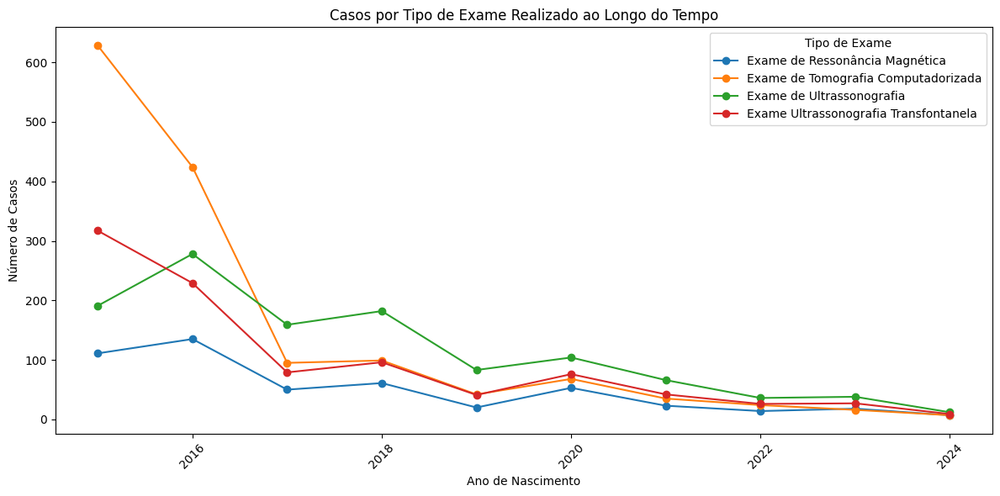

Loading ITables v2.5.2 from the internet... (need help?)


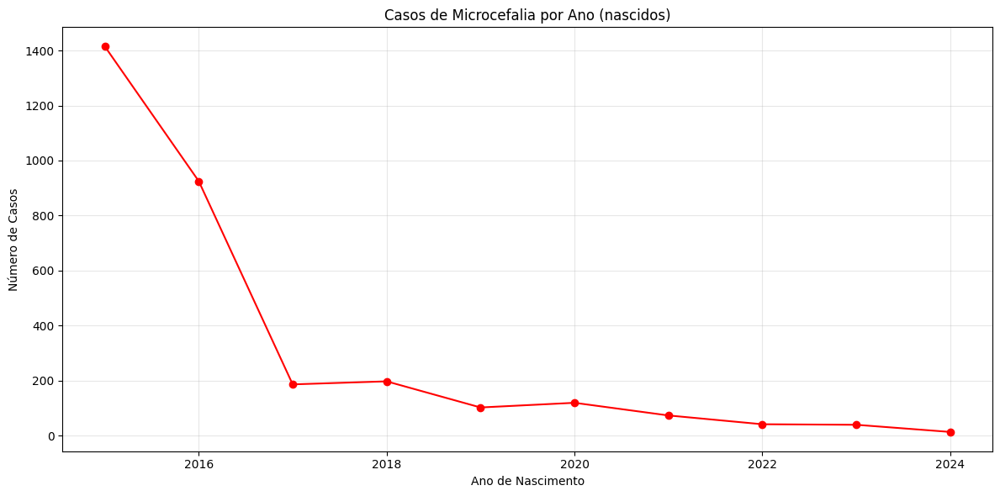

In [29]:
#Criação de Coluna Ano-mês para as 3
df_mapped['Ano-Mês Notificação'] = df_mapped['Data da Notificação'].dt.to_period('M')
df_mapped['Ano-Mês Nascimento'] = df_mapped['Data de Nascimento'].dt.to_period('M')
df_mapped['Ano-Mês Óbito'] = df_mapped['Data do Óbito'].dt.to_period('M')

#Visualização Gráfica
exames_por_ano_df.plot(kind='line', figsize=(12, 6), marker='o')
plt.title('Casos por Tipo de Exame Realizado ao Longo do Tempo')
plt.xlabel('Ano de Nascimento')
plt.ylabel('Número de Casos')
plt.xticks(rotation=45)
plt.legend(title='Tipo de Exame')
plt.tight_layout()
plt.show()

#Evolução de casos confirmados vs descartados ao longo do tempo (Gráficamente)
classificacao_por_ano = df_mapped.groupby(['Ano de Nascimento', 'Classificação Final']).size().unstack(fill_value=0)
itables.show(classificacao_por_ano)

# Define quais rótulos contam como “tem microcefalia”
MICRO_CATS = {
    'Microcefalia apenas',
    'Microcefalia com alteração do SNC',
    'Microcefalia com outras alterações congênitas'
}

# Garante datetime e deriva o ano
dft = df_mapped.copy()
dft['Data de Nascimento'] = pd.to_datetime(dft['Data de Nascimento'], errors='coerce')
dft = dft.dropna(subset=['Data de Nascimento'])

dft['Ano'] = dft['Data de Nascimento'].dt.year

# Conta casos com qualquer tipo de microcefalia por ano
micro_por_ano = (dft[dft['Microcefalia'].isin(MICRO_CATS)]
                 .groupby('Ano')
                 .size()
                 .rename('Casos'))

# Gráfico
ax = micro_por_ano.plot(kind='line', marker='o', color='red', figsize=(12,6))
ax.set_title('Casos de Microcefalia por Ano (nascidos)')
ax.set_xlabel('Ano de Nascimento')
ax.set_ylabel('Número de Casos')
ax.grid(True, alpha=.3)
plt.tight_layout()
plt.show()

# Cria coluna Ano-Mês a partir da data de nascimento
dft['AnoMes'] = dft['Data de Nascimento'].dt.to_period('M').dt.to_timestamp()

import plotly.express as px

# Gráfico de óbitos por mês
obitos_por_mes = dft.dropna(subset=['Data do Óbito']).groupby('AnoMes').size().rename('Óbitos')
fig_obitos = px.line(
    obitos_por_mes.reset_index(),
    x='AnoMes',
    y='Óbitos',
    markers=True,
    title='Óbitos por Mês'
)
fig_obitos.update_layout(
    xaxis_title='Ano-Mês do Óbito',
    yaxis_title='Número de Óbitos',
    template='plotly_white'
)
fig_obitos.show()

# Gráfico conjunto de óbitos e microcefalia por mês
micro_por_mes = (dft[dft['Microcefalia'].isin(MICRO_CATS)]
                 .groupby('AnoMes')
                 .size()
                 .rename('Microcefalia'))

conjunto_mes = pd.concat([micro_por_mes, obitos_por_mes], axis=1).fillna(0)
fig_conjunto = px.line(
    conjunto_mes.reset_index(),
    x='AnoMes',
    y=['Microcefalia', 'Óbitos'],
    markers=True,
    title='Microcefalia e Óbitos por Mês'
)
fig_conjunto.update_layout(
    xaxis_title='Ano-Mês',
    yaxis_title='Número de Casos',
    template='plotly_white'
)
fig_conjunto.show()


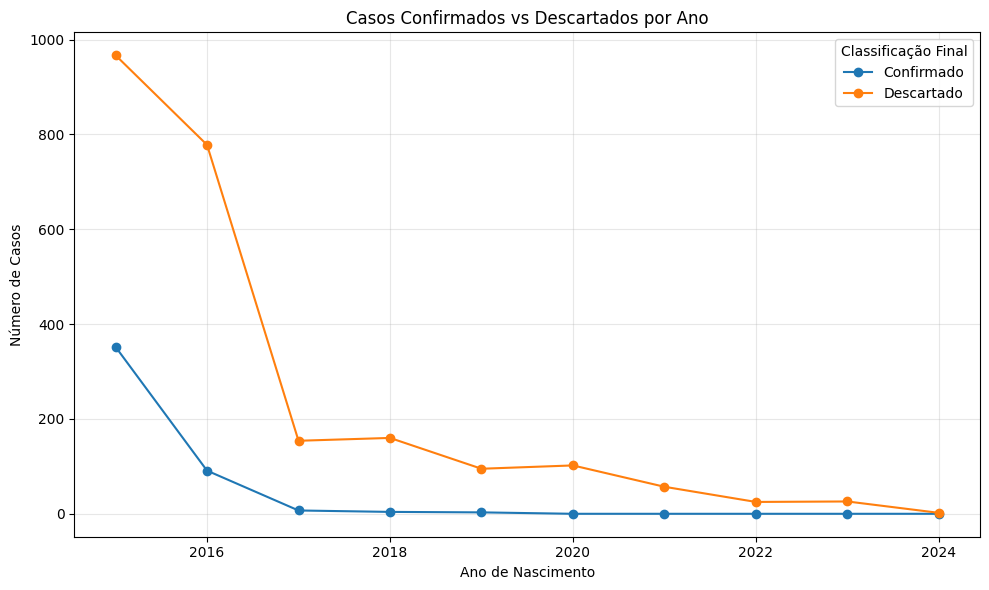

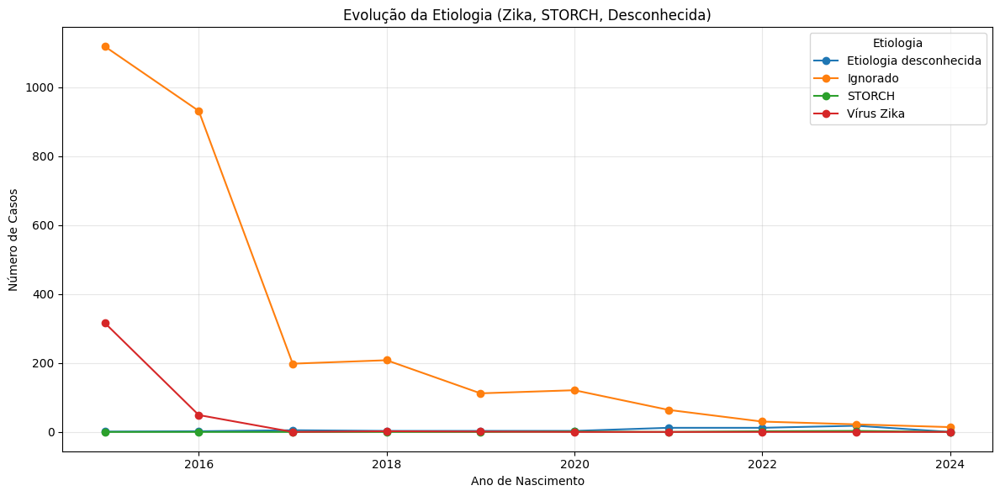

In [36]:
# Linha temporal de Etiologia e Casos Confirmados vs Descartados

casos_classif = df_mapped.groupby(['Ano de Nascimento', 'Classificação Final']).size().unstack(fill_value=0)

casos_classif[['Confirmado', 'Descartado']].plot(
    kind='line', marker='o', figsize=(10,6),
    title='Casos Confirmados vs Descartados por Ano'
)
plt.ylabel('Número de Casos')
plt.grid(True, alpha=.3)
plt.tight_layout()
plt.show()

etiologia_tempo = (
    df_mapped.groupby(['Ano de Nascimento', 'Etiologia'])
    .size()
    .unstack(fill_value=0)
)

etiologia_tempo.plot(
    kind='line', marker='o', figsize=(12,6),
    title='Evolução da Etiologia (Zika, STORCH, Desconhecida)'
)
plt.ylabel('Número de Casos')
plt.grid(True, alpha=.3)
plt.tight_layout()
plt.show()

#Proporção de casos confirmados (Plotly)
import plotly.express as px

df_indic = (
    df_mapped.groupby('Ano de Nascimento')['Classificação Final']
    .value_counts()
    .unstack(fill_value=0)
)
df_indic['Proporção Confirmados (%)'] = (
    df_indic['Confirmado'] / df_indic.sum(axis=1) * 100
)

fig_prop_conf = px.line(
    df_indic.reset_index(),
    x='Ano de Nascimento',
    y='Proporção Confirmados (%)',
    markers=True,
    title='Proporção de Casos Confirmados (%)'
)
fig_prop_conf.update_layout(
    xaxis_title='Ano de Nascimento',
    yaxis_title='% de Casos Confirmados',
    template='plotly_white'
)
fig_prop_conf.show()

#Taxa de Óbitos (Plotly)
taxa_obitos = (obitos_por_ano / micro_por_ano * 100).fillna(0)
fig_taxa_obitos = px.line(
    taxa_obitos.reset_index(),
    x='Ano do Óbito',
    y=0,
    markers=True,
    title='Taxa de Óbitos (%) entre Casos Confirmados'
)
fig_taxa_obitos.update_layout(
    xaxis_title='Ano de Nascimento',
    yaxis_title='% de Óbitos entre Confirmados',
    template='plotly_white'
)
fig_taxa_obitos.show()

#Proporção por Sexo (Plotly)
sexo_prop = (
    df_mapped.groupby(['Ano de Nascimento', 'Sexo'])
    .size()
    .unstack(fill_value=0)
)
sexo_prop = sexo_prop.div(sexo_prop.sum(axis=1), axis=0) * 100

sexo_prop_plot = sexo_prop.reset_index().melt(id_vars='Ano de Nascimento', var_name='Sexo', value_name='Proporção (%)')
fig_sexo_prop = px.line(
    sexo_prop_plot,
    x='Ano de Nascimento',
    y='Proporção (%)',
    color='Sexo',
    markers=True,
    title='Proporção de Casos por Sexo (%)'
)
fig_sexo_prop.update_layout(
    xaxis_title='Ano de Nascimento',
    yaxis_title='% de Casos',
    template='plotly_white'
)
fig_sexo_prop.show()

#Microcefalia e Obitos por mês (Plotly)
micro_obitos_mes = pd.concat([micro_por_mes, obitos_por_mes], axis=1).fillna(0)
fig_micro_obitos = px.line(
    micro_obitos_mes.reset_index(),
    x='AnoMes',
    y=['Microcefalia', 'Óbitos'],
    markers=True,       
    title='Microcefalia e Óbitos por Mês'
)
fig_micro_obitos.update_layout(
    xaxis_title='Ano-Mês',
    yaxis_title='Número de Casos',
    template='plotly_white'
)
fig_micro_obitos.show() 


#### Interpretação

Óbitos por Mês

há um pico expressivo entre novembro/2015 e janeiro/2016, quando os óbitos mensais chegam a mais de 25 casos. totalmente correlacionado com o numero de casos no periodo de Agosto de 2015 até Janeiro de 2016
Após esse ponto, há uma queda rápida e sustentada, com valores próximos de zero a partir de meados de 2017.
O pico coincide com o auge do surto de Zika vírus, quando os recém-nascidos afetados pela microcefalia apresentavam maiores complicações e mortalidade.
A redução progressiva mostra que, após a mobilização da rede de saúde e o controle do vetor, o número de casos graves diminuiu drasticamente.
A estabilização em níveis muito baixos após 2017 indica transição do cenário epidêmico para um padrão endêmico ou residual.

Microcefalia e Óbitos por Mês (comparativo)

As duas curvas (azul = microcefalia; vermelho = óbitos) seguem o mesmo padrão temporal, com picos quase sobrepostos entre final de 2015 e início de 2016.
O número de casos de microcefalia chega a mais de 700 notificações mensais no auge, enquanto os óbitos acompanham o aumento, mas em menor magnitude.
Após 2017, ambas as curvas se mantêm praticamente em linha de base, sem novos picos.

Essa correspondência temporal indica forte relação causal entre o surto de Zika e o aumento súbito de microcefalias e óbitos neonatais.
A defasagem leve (microcefalia primeiro, óbitos logo depois) reflete a progressão natural do desfecho clínico — bebês diagnosticados com microcefalia apresentando maior risco de morte nos meses subsequentes.
O desaparecimento simultâneo dos dois fenômenos reforça que a intervenção em saúde pública (controle do mosquito, vigilância, diagnóstico) foi efetiva.

Proporção de Casos Confirmados

A curva começa em 2015 com ~25% de casos confirmados, despenca para menos de 10% em 2016, e cai a quase 0% a partir de 2020.
Desde 2021, a proporção é praticamente nula.
Essa tendência reflete a redução real da circulação do vírus Zika e a melhoria na diferenciação diagnóstica (menos falsos positivos).
No início da epidemia, muitos casos eram classificados como confirmados por critérios clínico-epidemiológicos, sem confirmação laboratorial.
Com o tempo, a vigilância se aperfeiçoou e a proporção de confirmados caiu, indicando uma fase pós-epidêmica com notificações residuais (investigações de rotina, revisões ou reclassificações de casos antigos).



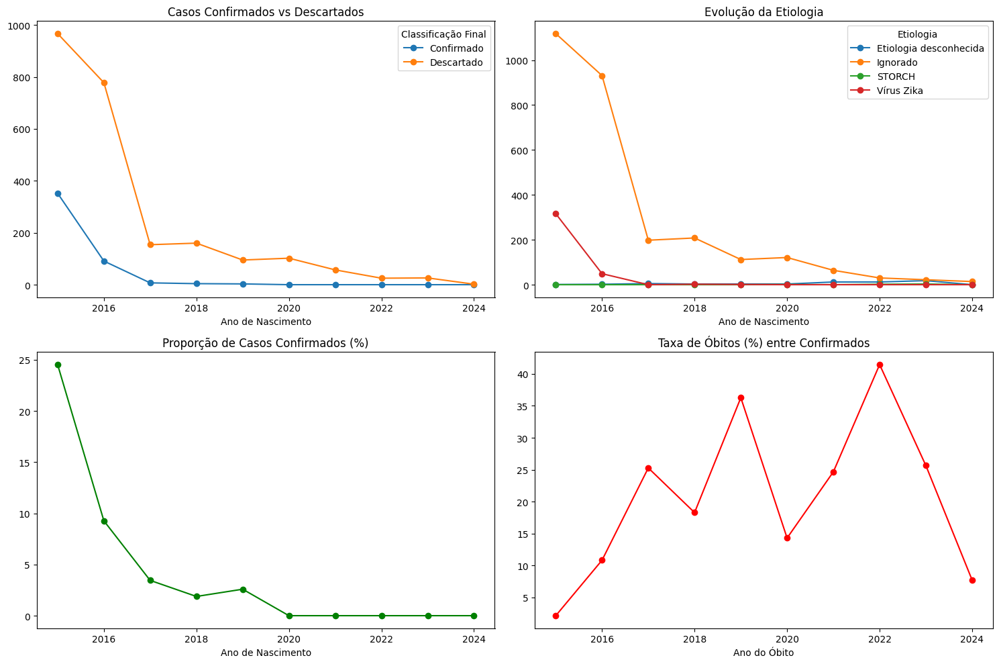

In [37]:
#Painel Temporal Integrado

fig, axs = plt.subplots(2, 2, figsize=(15,10))

# Confirmados x Descartados
casos_classif[['Confirmado', 'Descartado']].plot(ax=axs[0,0], marker='o', title='Casos Confirmados vs Descartados')

# Etiologia
etiologia_tempo.plot(ax=axs[0,1], marker='o', title='Evolução da Etiologia')

# Proporção Confirmados
df_indic['Proporção Confirmados (%)'].plot(ax=axs[1,0], color='green', marker='o', title='Proporção de Casos Confirmados (%)')

# Taxa de Óbitos
taxa_obitos.plot(ax=axs[1,1], color='red', marker='o', title='Taxa de Óbitos (%) entre Confirmados')

plt.tight_layout()
plt.show()


# Distribuição Espacial dos Casos

In [38]:
import pandas as pd
import geopandas as gpd
import json
import plotly.express as px

# --- Shapefile ---
shp = "C:/Users/mateu/Arquivos de Programas Faculdade/Repositorios/Analise-SCZ/Data/shapefiles/PE_Municipios_2024.shp"
mapa_pe = gpd.read_file(shp).to_crs(epsg=4326)

# Veja quais colunas existem para o código
print(mapa_pe.columns)

# Se o shapefile tiver CD_MUN com 7 dígitos, crie a chave de 6
# (ajuste o nome da coluna se for diferente, ex.: 'CD_MUN', 'CD_GEOCMU', etc.)
mapa_pe["CD_MUN"] = mapa_pe["CD_MUN"].astype(str).str.strip()
mapa_pe["CD_MUN6"] = mapa_pe["CD_MUN"].str[:6]  # pega os 6 primeiros dígitos

# --- Casos agregados por município ---
casos_mun = (
    df_mapped[df_mapped["Classificação Final"] == "Confirmado"]
    .groupby("Código Município de Residência")
    .size()
    .reset_index(name="Casos Confirmados")
)

# Normaliza a chave do CSV para 6 dígitos também
casos_mun["cod6"] = (
    casos_mun["Código Município de Residência"]
    .astype(str)
    .str.replace(r"\.0$", "", regex=True)
    .str.zfill(6)
)

# --- Merge geográfico ---
mapa_casos = mapa_pe.merge(
    casos_mun[["cod6", "Casos Confirmados"]],
    left_on="CD_MUN6",
    right_on="cod6",
    how="left"
)

mapa_casos["Casos Confirmados"] = mapa_casos["Casos Confirmados"].fillna(0).astype(int)

# Checagem rápida: total antes vs depois
print("Total confirmados na tabela:", casos_mun["Casos Confirmados"].sum())
print("Total após merge:", mapa_casos["Casos Confirmados"].sum())

# --- Plotly: use featureidkey para casar locations com a propriedade do GeoJSON ---
geojson = json.loads(mapa_casos.to_json())

fig = px.choropleth_mapbox(
    mapa_casos,
    geojson=geojson,
    locations="CD_MUN6",                    # <- esta coluna do GeoDataFrame
    featureidkey="properties.CD_MUN6",      # <- esta propriedade dentro do GeoJSON
    color="Casos Confirmados",
    hover_name="NM_MUN" if "NM_MUN" in mapa_casos.columns else None,
    color_continuous_scale="Reds",
    mapbox_style="carto-positron",
    zoom=6, center={"lat": -8.28, "lon": -37.95},
    title="Casos Confirmados de SCZ por Município - Pernambuco (2015–2024)"
)
fig.update_layout(margin=dict(l=0, r=0, t=40, b=0))
fig.show()




Index(['CD_MUN', 'NM_MUN', 'CD_RGI', 'NM_RGI', 'CD_RGINT', 'NM_RGINT', 'CD_UF',
       'NM_UF', 'SIGLA_UF', 'CD_REGIA', 'NM_REGIA', 'SIGLA_RG', 'CD_CONCU',
       'NM_CONCU', 'AREA_KM2', 'geometry'],
      dtype='object')
Total confirmados na tabela: 471
Total após merge: 471


In [56]:
#GeoDataFrame com geometrias + colunas quantitativa

import pandas as pd
import geopandas as gpd
import numpy as np

#leitura do shapefile
shp = r"C:/Users/mateu/Arquivos de Programas Faculdade/Repositorios/Analise-SCZ/Data/shapefiles/PE_Municipios_2024.shp"
gpe = gpd.read_file(shp).to_crs(epsg=4326)

#padroniza a chave de 6 dígitos para casar com o dataset
gpe["CD_MUN"]  = gpe["CD_MUN"].astype(str).str.strip()
gpe["CD_MUN6"] = gpe["CD_MUN"].str[:6]

#agregações no dataframe tabular
df = df_mapped.copy()

# garante a chave de 6 dígitos do CSV
df["cod6"] = (df["Código Município de Residência"].astype(str)
                .str.replace(r"\.0$", "", regex=True).str.zfill(6))

#filtros úteis
is_conf   = df["Classificação Final"].eq("Confirmado")
is_obito  = df["Status de Óbito"].eq("Sim")
is_micro  = df["Microcefalia"].ne("Alterações congênitas sem microcefalia")  # ou use == "Microcefalia apenas", se preferir

agg = (
    df.groupby("cod6")
      .agg(
          notificados=("cod6", "size"),
          confirmados=("Classificação Final", lambda s: (s=="Confirmado").sum()),
          descartados=("Classificação Final", lambda s: (s=="Descartado").sum()),
          obitos=("Status de Óbito",    lambda s: (s=="Sim").sum()),
          microcefalia=("Microcefalia", lambda s: s.ne("Alterações congênitas sem microcefalia").sum())
      )
      .reset_index()
)

#indicadores
agg["prop_confirmados_%"] = 100 * agg["confirmados"] / agg["notificados"]
agg["taxa_obito_confirmados_%"] = 100 * np.where(agg["confirmados"]>0, agg["obitos"]/agg["confirmados"], np.nan)

#GeoDataFrame final: geometria + métricas
gdf_pe = gpe.merge(agg, left_on="CD_MUN6", right_on="cod6", how="left")
num_cols = ["notificados","confirmados","descartados","obitos","microcefalia",
            "prop_confirmados_%","taxa_obito_confirmados_%"]
gdf_pe[num_cols] = gdf_pe[num_cols].fillna(0)

#Salvamento
gdf_pe.to_file("C:/Users/mateu/Arquivos de Programas Faculdade/Repositorios/Analise-SCZ/Data/shapefiles/pe_scZ_metrics.gpkg", layer="municipios", driver="GPKG")

#Visualização do GeoDataFrame
itables.show(gdf_pe.head())



Loading ITables v2.5.2 from the internet... (need help?)


In [40]:
#Mapa Coroplético com Geopandas

import json, plotly.express as px

geojson = json.loads(gdf_pe.to_json())

fig = px.choropleth_mapbox(
    gdf_pe,
    geojson=geojson,
    locations="CD_MUN6",
    featureidkey="properties.CD_MUN6",
    color="confirmados",                 # trocavel para 'microcefalia', 'obitos', etc.
    color_continuous_scale="Reds",
    hover_data={"NM_MUN":True, "confirmados":True, "notificados":True,
                "prop_confirmados_%":":.1f", "taxa_obito_confirmados_%":":.1f"},
    hover_name="NM_MUN",
    mapbox_style="carto-positron",
    center={"lat": -8.28, "lon": -37.95}, zoom=6,
    title="SCZ — Casos confirmados por município (2015–2024)"
)
fig.update_layout(margin=dict(l=0,r=0,t=40,b=0))
fig.show()


In [41]:
#Mapa Coroplético com Geopandas

import json, plotly.express as px

geojson = json.loads(gdf_pe.to_json())

# Remove 'centro' column if present to avoid JSON serialization error
gdf_plot = gdf_pe.drop(columns=["centro"], errors="ignore")

hover_cols = ["NM_MUN", "confirmados", "notificados", "prop_confirmados_%", "taxa_obito_confirmados_%"]
hover_data = {col: True for col in hover_cols if col in gdf_plot.columns}

fig = px.choropleth_mapbox(
    gdf_plot,
    geojson=geojson,
    locations="CD_MUN6",
    featureidkey="properties.CD_MUN6",
    color="obitos",  # troque para 'microcefalia', 'obitos', etc.
    color_continuous_scale="Reds",
    hover_data=hover_data,
    hover_name="NM_MUN",
    mapbox_style="carto-positron",
    center={"lat": -8.28, "lon": -37.95}, zoom=6,
    title="SCZ — Obitos por município (2015–2024)"
)
fig.update_layout(margin=dict(l=0, r=0, t=40, b=0))
fig.show()

In [42]:
#Mapa de Bolhas
pts = gdf_pe.copy()
pts["centro"] = pts.geometry.centroid
pts = pts.set_geometry("centro")

fig = px.scatter_mapbox(
    pts,
    lat=pts.geometry.y, lon=pts.geometry.x,
    size="confirmados",
    color="confirmados",
    color_continuous_scale="Reds",
    hover_name="NM_MUN",
    hover_data={"confirmados":True,"notificados":True},
    mapbox_style="carto-positron",
    zoom=6, center={"lat": -8.28, "lon": -37.95},
    title="SCZ — Bolhas (centróides) por município"
)
fig.update_layout(margin=dict(l=0,r=0,t=40,b=0))
fig.show()


C:\Users\mateu\AppData\Local\Temp\ipykernel_21396\1668512224.py:3: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




C:\Users\mateu\AppData\Local\Temp\ipykernel_20840\4112054994.py:12: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning

c:\Users\mateu\AppData\Local\Programs\Python\Python312\Lib\site-packages\libpysal\weights\contiguity.py:347: UserWarning:

The weights matrix is not fully connected: 
 There are 2 disconnected components.
 There is 1 island with id: 153.

c:\Users\mateu\AppData\Local\Programs\Python\Python312\Lib\site-packages\esda\moran.py:1354: RuntimeWarning:

invalid value encountered in divide

c:\Users\mateu\AppData\Local\Programs\Python\Python312\Lib\site-packages\esda\getisord.py:527: RuntimeWarning:

invalid value encountered in divide

c:\Users\mateu\AppData\Local\Programs\Python\Python312\Lib\site-packages\esda\getisord.py:450: RuntimeWarning:

invalid value encountered in divide



('WARNING: ', 153, ' is an island (no neighbors)')
Moran's I: 0.479  |  p-valor (permutações): 0.0010


(-41.807364615, -31.928739485, -9.766811160000001, -3.52070844)

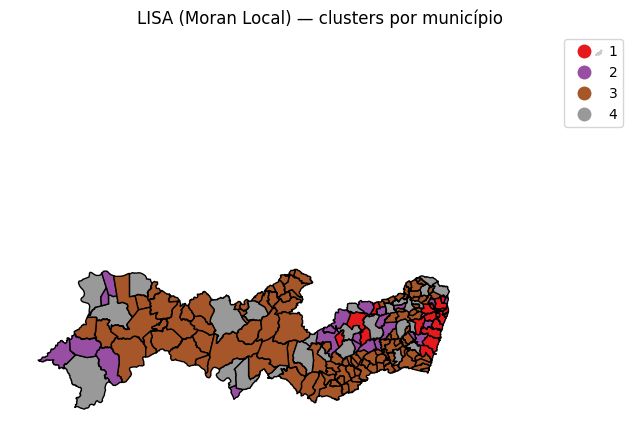

In [ ]:
#Autocorrelação espacial (Moran's I)

from libpysal.weights import Queen, lag_spatial
from esda.moran import Moran, Moran_Local
from esda.getisord import G_Local
import numpy as np

#variável de interesse (ex.: confirmados por município)
y = gdf_pe["confirmados"].astype(float).values

#matriz de vizinhança por contiguidade (Queen)
w = Queen.from_dataframe(gdf_pe)
w.transform = "r"  # row-standardized

#Moran Global
mi = Moran(y, w)
print(f"Moran's I: {mi.I:.3f}  |  p-valor (permutações): {mi.p_sim:.4f}")

#LISA (Moran Local) — clusters alto-alto, baixo-baixo, etc.
lisa = Moran_Local(y, w, n_jobs=1)  # Force single-threaded to avoid worker errors
gdf_pe["lisa_sig"]  = lisa.p_sim < 0.05
gdf_pe["lisa_quad"] = lisa.q   # 1=HH, 2=LH, 3=LL, 4=HL

#Getis-Ord Gi* — hotspots
gi = G_Local(y, w, transform='r', n_jobs=1)  # Force single-threaded
gdf_pe["gi_star"] = gi.Zs  # z-score; >1.96 ~ hotspot ao nível 5%

 #Visualização rápida (geopandas)
ax = gdf_pe.plot(column="lisa_quad", categorical=True, legend=True,
                 figsize=(8,6), cmap="Set1", edgecolor="k",
                 missing_kwds={"color":"lightgrey","hatch":"///","label":"sem dados"})
ax.set_title("LISA (Moran Local) — clusters por município")
ax.axis("off")


### Interpretação dos Mapas

#### LISA - CLusters por Município

O LISA avalia a autocorrelação espacial local, ou seja, se um município tende a ter valores semelhantes (altos ou baixos) aos de seus vizinhos.
Ele detecta clusters espaciais (agrupamentos significativos) e outliers.
As cores representam tipos de associação espacial entre o valor do município e o valor médio dos seus vizinhos:

Cor	Cluster	Interpretação
Vermelho 1 (High-High)	Municípios com alta incidência cercados por municípios também de alta incidência. Representa hotspots.	
Roxo 2 (Low-Low)	Municípios com baixa incidência cercados por municípios de baixa incidência. Representa zonas frias.	
Marrom 3 (High-Low)	Municípios com alta incidência isolados por vizinhos de baixa incidência — possíveis outliers locais.	
Cinza 4 (Low-High)	Municípios com baixa incidência cercados por vizinhos com alta — áreas potencialmente protegidas ou transição.	
(cinza sem cluster significativo)	Áreas onde não há relação espacial estatisticamente significativa.	
Para Pernambuco
Faixa litorânea e Zona da Mata (leste):
Concentra clusters High-High, ou seja, focos do surto de SCZ — regiões onde municípios com muitos casos estão próximos uns dos outros (Recife, Olinda, Paulista, Caruaru etc.).
Isso reflete o epicentro inicial da epidemia de Zika (2015–2016).

Sertão e extremo oeste:
Predominam clusters Low-Low, mostrando baixa incidência estável e menor correlação espacial de risco.
→ Possível explicação: menor densidade populacional, menor exposição urbana e diferenças no sistema de vigilância e incidência do mosquito.

Alguns municípios do Agreste e Sertão Central:
Mostram High-Low — áreas que tiveram casos isolados fora dos principais focos regionais, indicando outliers espaciais.

Esse mapa mostra padrões espaciais significativos:
Cluster de alta incidência (hotspot) concentrado no litoral e zona da mata, onde a epidemia foi mais intensa.
Cluster de baixa incidência (coldspot) no sertão, indicando áreas menos afetadas.
Outliers que podem indicar subnotificação ou transmissão localizada fora dos centros urbanos principais.

#### Distribuição de Casos e Óbitos por Município (2015–2024)
O mapa de casos confirmados mostra uma concentração significativa na Região Metropolitana do Recife (RMR), especialmente nos municípios de Recife, Jaboatão dos Guararapes, Olinda e Paulista. Essa concentração pode estar associada à maior densidade populacional, à melhor capacidade diagnóstica e à notificação mais eficiente nesses centros urbanos.
Além disso, nota-se ocorrência moderada em Petrolina e arredores, no Sertão do São Francisco, indicando que o vírus se espalhou por todo o estado, ainda que de forma desigual.

O mapa de óbitos apresenta padrão espacial semelhante, com destaque novamente para Recife e municípios vizinhos, o que reforça o impacto da SCZ nas regiões urbanizadas.
Entretanto, observa-se também concentração relevante de óbitos em Petrolina, o que pode indicar subnotificação em outras áreas e melhor infraestrutura hospitalar nessa cidade, permitindo registro mais preciso dos casos fatais.

3️⃣ Distribuição Geral e Densidade de Focos

O mapa de densidade de focos (círculos sobrepostos) reforça o peso epidemiológico da RMR, representando os principais polos de transmissão e registro.
A presença de pontos mais claros no interior do estado (Caruaru, Garanhuns, Serra Talhada, etc.) sugere transmissão mais difusa e menos intensa, possivelmente associada à menor concentração populacional e limitação no diagnóstico laboratorial.

# Modelagem de Regressão Espacial


In [57]:
%pip install pysal

import numpy as np
from pysal.lib import weights
from pysal.model import spreg

#Pesos por contiguidade (rainha: borda ou vértice em comum)
w = weights.contiguity.Queen.from_dataframe(gdf_pe)

#Normaliza os pesos (importante!)
w.transform = 'r'

# Variável dependente
y = gdf_pe[['confirmados']].values

# Variáveis explicativas — escolha as que fazem sentido
# (colunas quantitativas e não correlacionadas demais)
X = gdf_pe[['notificados', 'prop_confirmados_%', 'taxa_obito_confirmados_%']].fillna(0).values


  DEPRECATION: Building 'spint' using the legacy setup.py bdist_wheel mechanism, which will be removed in a future version. pip 25.3 will enforce this behaviour change. A possible replacement is to use the standardized build interface by setting the `--use-pep517` option, (possibly combined with `--no-build-isolation`), or adding a `pyproject.toml` file to the source tree of 'spint'. Discussion can be found at https://github.com/pypa/pip/issues/6334


  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
   ---------------------------------------- 0.0/882.2 kB ? eta -:--:--
   ---------------------------------------- 882.2/882.2 kB 6.6 MB/s  0:00:00
   ---------------------------------------- 0.0/1.7 MB ? eta -:--:--
   ---------------------------------------- 1.7/1.7 MB 18.9 MB/s  0:00:00
   ---------------------------------------- 0.0/2.7 MB ? eta -:--:--
   ---------------------------------------- 2.7/2.7 MB 17.6 MB/s  0:00:00
   ---------------------------------------- 0.0/38.1 MB ? eta -:--:--
   ------- -------------------------------- 7.6/38.1 MB 36.2 MB/s eta 0:00:01
   --------------- ------------------------ 15.2/38.1 MB 36.8 MB/s eta 0:00:01
   ------------------------ --------------- 23.1/38.1 MB 37.4 MB/s eta 0:00:01
   -------------------------------- ------- 30.9/38.1 MB 37.0 MB/s eta 0:00:01
   ---------------------------------------  38.0/38.1 MB 37.2 MB/s eta 0:00:01


C:\Users\mateu\AppData\Local\Temp\ipykernel_21396\3561488747.py:8: FutureWarning:

`use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning



('WARNING: ', 153, ' is an island (no neighbors)')


c:\Users\mateu\AppData\Local\Programs\Python\Python312\Lib\site-packages\libpysal\weights\contiguity.py:347: UserWarning:

The weights matrix is not fully connected: 
 There are 2 disconnected components.
 There is 1 island with id: 153.



In [58]:
# Regressão normal para comparação
ols = spreg.OLS(y, X, name_y='confirmados', name_x=['notificados', 'prop_confirmados_%', 'taxa_obito_confirmados_%'])
print(ols.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :        None
Dependent Variable  : confirmados                Number of Observations:         185
Mean dependent var  :      2.5459                Number of Variables   :           4
S.D. dependent var  :      7.4388                Degrees of Freedom    :         181
R-squared           :      0.9339
Adjusted R-squared  :      0.9328
Sum squared residual:     672.746                F-statistic           :    852.7980
Sigma-square        :       3.717                Prob(F-statistic)     :  1.699e-106
S.E. of regression  :       1.928                Log likelihood        :    -381.922
Sigma-square ML     :       3.636                Akaike info criterion :     771.845
S.E of regression ML:      1.9070                Schwarz criterion     :     784.726

------------------------------------------------------------

c:\Users\mateu\AppData\Local\Programs\Python\Python312\Lib\site-packages\tqdm\auto.py:21: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html



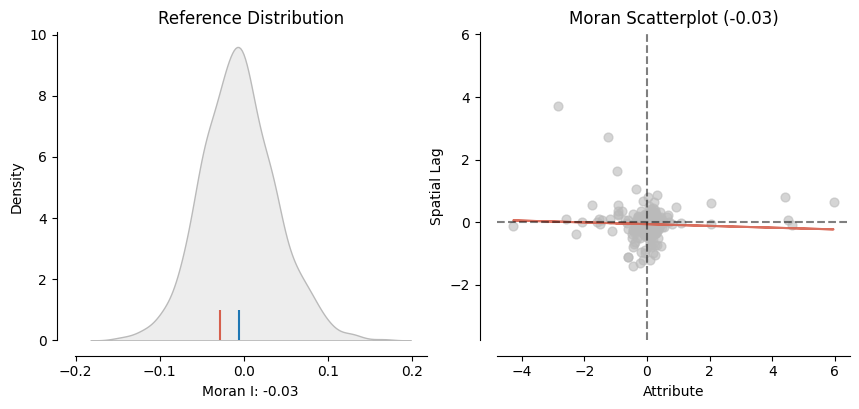

In [61]:
gdf_pe['residuos'] = ols.u  # resíduos do modelo OLS
from splot.esda import moran_scatterplot, plot_moran
from esda import Moran

moran = Moran(gdf_pe['residuos'], w)
plot_moran(moran, zstandard=True, scatter_kwds=dict(alpha=0.6))
plt.show()


### Entendimento do modelo

A regressão linear clássica (OLS)
O Modelo tenta responder “Quais fatores ajudam a explicar o número de casos confirmados de SCZ nos municípios de Pernambuco?”
Utilizando: 

Notificados → quantos casos foram registrados (independente de confirmação)
Proporção de confirmados → quanto do total foi confirmado
Taxa de óbitos entre confirmados → indicador de gravidade

Número de observações: 185	São 185 municípios analisados	
R² = 0,9339 (93,39%)	O modelo consegue explicar 93% das diferenças entre os municípios quanto ao número de casos confirmados. Isso é muito alto, indicando que o modelo encaixou bem nos dados.	
R² ajustado = 0,9328	Corrige o R² para o número de variáveis — continua excelente.	
F-statistic = 852,8 (p < 0,001)	Esse é um teste que pergunta: “essas variáveis explicam algo de fato ou é sorte?” → O resultado mostra que sim, o modelo é altamente significativo.	
AIC / Schwarz (BIC)	São números que medem a qualidade do modelo. Você só vai usá-los para comparar com outros modelos depois (por exemplo, quando fizer a regressão espacial). Quanto menor o AIC, melhor o modelo.

Variável	Sinal	Interpretação fácil
Intercepto (-0.816)	Negativo	É o ponto de partida do modelo. Como as variáveis nunca são “zero” na prática, ele serve mais como ajuste matemático.
Notificados (+0.1536)	Positivo e muito forte	Isso quer dizer que quanto mais casos são notificados, mais casos acabam confirmados. Faz todo o sentido até porque mais busca, mais confirmação. Cada 1 notificação a mais aumenta, em média, 0,15 casos confirmados.
Proporção de confirmados (%) (+0.0658)	Positivo e forte	Municípios que têm uma proporção maior de confirmações tendem também a ter mais casos confirmados absolutos. Isso indica eficiência de vigilância ou surtos mais intensos.
Taxa de óbitos entre confirmados (%) (-0.0059)	Negativo e leve	Onde há muitos óbitos, costuma haver menos casos confirmados — talvez porque nesses locais os casos são mais graves, mas a detecção é menor (subnotificação).

#### Testes de Qualidade de resíduos (Diferença da "previsão" e do fato)
Resíduos deveriam ser aleatórios

Teste de Breusch-Pagan:	
Verifica se os resíduos são parecidos entre municípios (variância constante)
Resultado: não são. Ou seja, alguns municípios têm resíduos muito maiores que outros.
Teste de Koenker-Bassett	
Confirma o mesmo, mas é mais resistente a dados “não perfeitos” Também confirma que os resíduos não são homogêneos.

O modelo linear explicou muita coisa, mas não explicou tudo.
Parece que existe um padrão geográfico nos erros

In [ ]:
#Modelação com Spatial lag Model
# Nesse modelo valores de y em vizinhos influenciam diretamente o y local (efeito difusivo)

lag = spreg.ML_Lag(y, X, w=w, name_y='confirmados', name_x=['notificados', 'prop_confirmados_%', 'taxa_obito_confirmados_%'])
print(lag.summary)


REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: MAXIMUM LIKELIHOOD SPATIAL LAG (METHOD = FULL)
-----------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  : confirmados                Number of Observations:         185
Mean dependent var  :      2.5459                Number of Variables   :           5
S.D. dependent var  :      7.4388                Degrees of Freedom    :         180
Pseudo R-squared    :      0.9532
Spatial Pseudo R-squared:  0.9554
Log likelihood      :   -350.9453
Sigma-square ML     :      2.5773                Akaike info criterion :     711.891
S.E of regression   :      1.6054                Schwarz criterion     :     727.992

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
---------------------------------------------------------------

### Entendimento do Modelo

O modelo de regressão espacial do tipo Spatial Lag apresentou um ajuste superior ao modelo linear tradicional, explicando cerca de 95% da variação no número de casos confirmados de SCZ nos municípios de Pernambuco. Todos os coeficientes foram estatisticamente significativos e mantiveram o mesmo sinal esperado, reforçando a relação positiva entre notificações, proporção de confirmados e número total de casos.
O coeficiente espacial (ρ = 0,21; p < 0,001) indica a presença de um efeito de vizinhança, mostrando que municípios com altos números de casos confirmados tendem a estar próximos de outros municípios também afetados. Isso revela dependência espacial positiva e um padrão de difusão regional da doença, característico de epidemias com dinâmica territorial, como a síndrome congênita associada ao Zika vírus.
Em resumo, a incorporação da dimensão espacial melhorou o poder explicativo do modelo, reduziu os erros e evidenciou que a SCZ não se distribui aleatoriamente no território pernambucano, mas apresenta aglomerados regionais de alta incidência, exigindo políticas públicas articuladas entre municípios vizinhos.

In [60]:
#Modelação com Spatial Error Model
# o Erro espacialmente correlacionado explica a dependência (não o y em si).

error = spreg.ML_Error(y, X, w=w, name_y='confirmados', name_x=['notificados', 'prop_confirmados_%', 'taxa_obito_confirmados_%'])
print(error.summary)


c:\Users\mateu\AppData\Local\Programs\Python\Python312\Lib\site-packages\spreg\ml_error.py:184: RuntimeWarning:

Method 'bounded' does not support relative tolerance in x; defaulting to absolute tolerance.



REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ML SPATIAL ERROR (METHOD = full)
---------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  : confirmados                Number of Observations:         185
Mean dependent var  :      2.5459                Number of Variables   :           4
S.D. dependent var  :      7.4388                Degrees of Freedom    :         181
Pseudo R-squared    :      0.9339
Log likelihood      :   -380.9211
Sigma-square ML     :      3.5313                Akaike info criterion :     769.842
S.E of regression   :      1.8792                Schwarz criterion     :     782.724

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT        -1.04351    

### Entendimento do Modelo

O modelo de regressão espacial do tipo Spatial Error apresentou um ajuste ligeiramente melhor que o modelo linear tradicional, com explicação de cerca de 93% da variação dos casos confirmados. As variáveis principais — número de notificações, proporção de casos confirmados e taxa de óbitos — mantiveram-se estatisticamente significativas e coerentes com os resultados anteriores.

O coeficiente espacial λ (-0,32; p = 0,008) revelou dependência espacial significativa nos resíduos, indicando que há padrões regionais não capturados diretamente pelas variáveis do modelo. Em outras palavras, existem fatores compartilhados entre municípios vizinhos (como condições ambientais, cobertura de vigilância, acesso a exames ou fatores socioeconômicos) que influenciam de maneira similar o número de casos confirmados.

Apesar disso, o desempenho global do modelo Spatial Error foi inferior ao do Spatial Lag, sugerindo que a interação direta entre municípios vizinhos é mais relevante para explicar a disseminação espacial da SCZ do que apenas fatores regionais não observados. Assim, o fenômeno parece ter uma natureza de difusão espacial ativa, onde os casos em um município estão fortemente relacionados aos casos dos seus vizinhos, refletindo um processo típico de propagação territorial de doenças infecciosas.

### Tabela comparativa de resultados (Feita com ChatGPT)

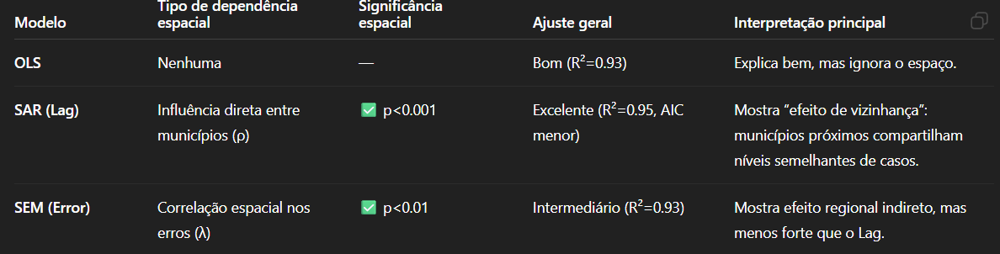